# Exploring Rāga Performance in Carnatic Music
Thomas Nuttall, Genís Plaja-Roglans, Lara Pearson, Brindha Manickavasakan

In this notebook we demonstrate the use of the [compIAM](https://github.com/MTG/compIAM/tree/master/compiam) repository for a music analysis task. The task will touch on elements of ongoing research by the authors on the analysis of rāga in Carnatic Music. The idea is primarily to demonstrate how the repository could support musicological inquiry and music analysis whilst also shining a light on certain characteristics of Carnatic Music and demonstrating how the use of computational tools for music analysis can assist in making explicit some of the implicit knowledge held by musicians and practitioners. This notebook and the results presented in it do not intend to serve as a musicological study.

#### About the authors
Many parts of this notebook and the accompanying discussion is directly taken from ongoing research between MIR researchers, Thomas Nuttall and Genís Plaja-Roglan; musicologist, Lara Pearson; and professional Carnatic vocalist, Brindha Manickavasakan. The objective of this collaboration is to develop computational processes that support musicological research of Carnatic Music, emphasising the importance of including performer's perspectives from the outset and providing results interpretable by, and of use to, practitioners.

#### Requirements and Setup
All code in the notebook can be ran using the compIAM package, some other, common, non-native packages are used, but these are all dependencies of compIAM and should be installed correctly with the installation of compIAM:

```pip install compiam```

An important thing to note is that this notebook relies on the [Saraga Carnatic Dataset](https://mtg.github.io/saraga/). It is advisable to have this (or at least part of this) downloaded before commencing. In its entirety, this dataset is >20GB and can take time downloading (although it is also possible to download indiviudal tracks). Alternatively, we encourage the reader to use their own audio for the analysis. 

**Table of Contents**

1. [Background](#1)<br>
    1.1 [What is rāga?](#1.1)<br>
2. [Data](#2)<br>
    2.1 [Exploring the Saraga Dataset](#2.1)<br>
    2.2 [An example performance](#2.2)<br>
3. [Pitch analysis](#3)<br>
    3.1 [Predominant pitch track extraction](#3.1)<br>
    3.2 [Visualising pitch track](#3.2)<br>
    3.3 [Introduction to pitch histograms](#3.3)<br>
    3.4 [Histogram extraction](#3.4)<br>
    3.5 [Pitch histogram across rāga](#3.5)<br>
    3.6 [Pitch histogram as feature](#3.6)<br>
    3.7 [Performance clustering](#3.7)<br>
4. [Melodic pattern analysis](#4)<br>
    4.1 [Melodic feature extraction](#4.1)<br>
    4.2 [Self similarity](#4.2)<br>
    4.3 [Segment extraction](#4.3)<br>
    4.4 [Segment grouping](#4.4)<br>
    4.5 [Exploring results](#4.5)<br>
    4.6 [Annotations](#4.6)<br>
    4.7 [Evaluation](#4.7)<br>
    4.8 [Discussion](#4.7)<br>
5. [Conclusion](#5)<br>
6. [References](#6)<br>
<a id='1'></a>
<a id='1.1'></a>

Let's import compiam and get started!

In [1]:
import compiam

## 1. Background
### 1.1 What is rāga?
The melodic frameworks on which Carnatic music is based are known as rāgas. One of the main aesthetic goals of Carnatic performance is the correct expression of rāga. Rāgas can be understood as collections of phrases or melodies, comprising gamakas (ornamentation) and svaras (notes) that are considered part of the melodic framework, and performed in ways that follow the grammar of the rāga. [1]

**Svaras** are note-length units with theoretical pitch positions, and are referred to using sargam syllables – sa ri ga ma pa dha and ni. Sargam syllables are used in written notation, and also in certain musical formats when the svara names are sung.

In practice, most svaras are performed with **gamakas** (ornamentation), rather than as plain notes [2]. Therefore, although svaras are often referred to using the English term ‘notes’, they differ from notes in that the gamakas with which they are performed are considered integral to the svara [3]. Many rāgas involve heavy use of **gamakas** such as oscillations, slides and flicks to other pitches. It is important to note that gamakas are not superficial decoration but rather are integral to musical meaning [3]. Gamakas, can greatly alter the sound of the notated svaras (notes); for example, some gamakas do not rest at all on the theoretical pitch of the notated svara, and instead involve oscillations between pitches either side of it.

Another important feature of the style is the structural and expressive significance of motifs and phrases known as **sañcāras**, which can be defined as coherent segments of melodic movement that follow the grammar of the rāga [3, 4]. The term sañcāra comes from the Sanskrit root सञ्चर्, meaning to move. Although occasionally the term might be used to refer to phrases that are particularly characteristic of a rāga, the more common use of the term is in reference to any melodic segment that is coherent from a Carnatic music perspective.

These melodic patterns are the means through which the character of the rāga is expressed and they form the basis of various improvisatory and compositional formats in the style [3, 5]. There are no definitive lists of all possible sañcāras in each rāga, rather the body of existing compositions and the living oral tradition of rāga performance act as repositories for that knowledge.

*(Text taken from [accompanying webbook](https://mtg.github.io/IAM-tutorial-ismir22/indian_art_music/carnatic-music.html))*
<a id='1.3'></a>

## 2. Data
### 2.1 Exploring the Saraga dataset
CompIAM provides access to 8 Indian Art Music datasets via the [mirdata library](https://github.com/mir-dataset-loaders/mirdata). These datasets cover the Carnatic and Hindustani styles and include a mixture of melodic and rhythmic data.

In [2]:
compiam.list_datasets()

['saraga_carnatic',
 'saraga_hindustani',
 'mridangam_stroke',
 'four_way_tabla',
 'compmusic_carnatic_rhythm',
 'compmusic_hindustani_rhythm',
 'compmusic_raga',
 'compmusic_indian_tonic']

The datasets can be accessed using `compiam.load_dataset()` and explored using the mirdata API. In this walkthrough we use the [Saraga Carnatic dataset](https://mtg.github.io/saraga/), which includes 249 individual carnatic performances from a range of performers across many rāgas. The performances are annotated with metadata such as tonic, rāga and tala and for 168 of them closed-microphone recordings of each individual instrument is included.

To load the dataset metadata pass a `data_home` to `load_dataset()`. This `data_home` should be a path to a directory where the mirdata has been/will be downloaded.

In [2]:
data_home = os.path.join('..', 'data', 'saraga1.5_carnatic','')

In [3]:
saraga = compiam.load_dataset('saraga_carnatic', data_home=data_home)

NameError: name 'compiam' is not defined

If the data is not yet downloaded you can download and validate it using:

In [6]:
#saraga.download()
#saraga.validate()

The Saraga dataset is quite large, this step should take a relatively long time to complete.

To load all data relating to each track in the dataset:

In [7]:
track_data = saraga.load_tracks()

Each track in `track_data` contains all path information relating to the performance, metadata (such as rāga, tala, performer) and some automatically extracted features such as tonic and preodminant pitch track.

In [8]:
track_data["108_Pullum_Silambena_Kan"]

Track(
  audio_ghatam_path=None,
  audio_mridangam_left_path=None,
  audio_mridangam_right_path=None,
  audio_path="...ani Mahal by Sanjay Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahmanyan - Pullum Silambena Kan.mp3",
  audio_violin_path=None,
  audio_vocal_path=None,
  audio_vocal_s_path=None,
  ctonic_path="...al by Sanjay Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahmanyan - Pullum Silambena Kan.ctonic.txt",
  metadata_path="...ni Mahal by Sanjay Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahmanyan - Pullum Silambena Kan.json",
  phrases_path="...jay Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahmanyan - Pullum Silambena Kan.mphrases-manual.txt",
  pitch_path="...hal by Sanjay Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahmanyan - Pullum Silambena Kan.pitch.txt",
  pitch_vocal_path=None,
  sama_path="... Sanjay Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahmanyan - Pullum Silambena Kan.sama-manual.txt",
  sections_path="...y Subrahmanyan/Pullum Silambena Kan/Sanjay Subrahm

In [9]:
track_data["108_Pullum_Silambena_Kan"].metadata

{'raaga': [{'uuid': 'a2f9f182-0ceb-4531-b286-b840b47a54b8',
   'name': 'Śankarābharaṇaṁ'}],
 'form': [{'name': 'Kriti'}],
 'title': 'Pullum Silambena Kan',
 'work': [{'mbid': '37a22a82-57ea-41fe-be9e-5aa5114b6dab',
   'title': 'Pullum Silambena'}],
 'length': 363000,
 'taala': [{'uuid': '7eb02ed9-2dcb-471f-9a8a-a09aa5cea633',
   'name': 'Miśra chāpu'}],
 'album_artists': [{'mbid': 'beab6365-8162-4c64-8922-64702cea3227',
   'name': 'Sanjay Subrahmanyan'}],
 'mbid': '9db9ebab-4238-4776-8531-6221547e2cb5',
 'artists': [{'instrument': {'mbid': 'f689271c-37bc-4c49-92a3-a14b15ee5d0e',
    'name': 'Mridangam'},
   'attributes': '',
   'lead': False,
   'artist': {'mbid': '0384e591-e929-4598-b715-dba96c942936',
    'name': 'Neyveli B Venkatesh'}},
  {'instrument': {'mbid': '089f123c-0f7d-4105-a64e-49de81ca8fa4',
    'name': 'Violin'},
   'attributes': 'additional',
   'lead': False,
   'artist': {'mbid': '49d91668-8166-424c-bc42-ca3954b1ae54',
    'name': 'Nagai R. Sriram'}},
  {'instrument': 

Explore some quick stats

In [10]:
n_tracks = len(track_data)
metadata = [t.metadata for _,t in track_data.items()]

# rāgas
ragas = [m['raaga'] for m in metadata]
ragas = [r[0]['name'] if r else 'unknown' for r in ragas]
unique_ragas = list(set(ragas))
n_ragas = len(unique_ragas)

In [11]:
print(f'Number of recordings: {n_tracks}')
print(f'    across {n_ragas} distinct ragas...')
for r in unique_ragas[:50]:
    print(f"      {r}")
print('      ...')

Number of recordings: 249
    across 97 distinct ragas...
      Kēdāragauḷa
      Tillāng
      Jaganmōhini
      Yamuna kalyāṇi
      Vāgadīśvari
      Latāngi
      Behāg
      Hamīr kaḷyaṇi
      Ānandabhairavi
      Pāḍi
      Sindhumandāri
      Bēgaḍa
      Śankarābharaṇaṁ
      Gaṁbhīra nāṭa
      Simhēndra madhyamaṁ
      Bhūṣāvaḷi
      Kathanakutūhalaṁ
      Vasanta
      Kāpi
      Bhairavi
      Madhyamāvati
      Gauḷa
      Śrīranjani
      Dhanyāsi
      Ṣanmukhapriya
      Harikāmbhōji
      Kuntalavarāḷi
      Nīlāṁbari
      Kalāvati
      Sahānā
      Kalyāṇi
      Nādanāmakriya
      Mandāri
      Bahudāri
      Ābhōgi
      Kedāraṁ
      Kāṁbhōji
      Tōḍi
      Amṛtavarṣiṇi
      Hamsadhvani
      Haṁsānandi
      Bāgēśrī
      Rītigauḷa
      Kumudakriyā
      Sucaritra
      Jōnpuri
      Rasikapriya
      Varāḷi
      Suraṭi
      Śudda sāvēri
      ...


<a id='2.2'></a>

### 2.2 An example performance
Let us take a look at a particular performance for a chosen raga

In [21]:
raga = "Rītigauḷa"

Get data for all performances related to this raga

In [22]:
raga_tracks = {k:v for i,(k,v) in enumerate(track_data.items()) if ragas[i]==raga}

List all titles and artists for this raga

In [23]:
print(f"{len(raga_tracks)} {raga} performances...")
for rt in raga_tracks.values():
    name = rt.metadata['album_artists'][0]['name']
    concert = rt.metadata['concert'][0]['title']
    title = rt.metadata['title']
    print(f'    {title} by {name} from {concert}')

4 Rītigauḷa performances...
    Koti Janmani by Akkarai Sisters from Akkarai Sisters at Arkay
    Ninnuvina Marigalada by Vasundara Rajagopal from Vasundara Rajagopal at Arkay
    Janani by Sanjay Subrahmanyan from Sanjay at Sastri Hall
    Vanajaksha Ninne Kori by Sumithra Vasudev from Sumitra Vasudev at Arkay


Take an example performance from the list

In [24]:
i = 0 # performance number

In [25]:
track = list(raga_tracks.values())[i]
name = track.metadata['album_artists'][0]['name']
concert = track.metadata['concert'][0]['title']
title = track.metadata['title']

In [26]:
print(f'{title} by {name} from {concert}')

Koti Janmani by Akkarai Sisters from Akkarai Sisters at Arkay


The track object contains paths to audio for all instrument tracks. As mentioned, some performances include close-microphone recordings so we can extract each track corresponding to each of those

In [27]:
# Mix
audio_path = track.audio_path
# Ghatam
ghatam_path = track.audio_ghatam_path
# Mridangam 
mridangam_left = track.audio_mridangam_left_path
mridangam_right = track.audio_mridangam_right_path
# Violin
violin_path = track.audio_violin_path
# Vocal
vocal_path = track.audio_vocal_path
accompanying_vocal_path = track.audio_vocal_s_path

However, not all tracks do have individual instrument tracks. For those that don't, we take the mixed path, stored in the `audio_path` attribute

In [28]:
_paths = [vocal_path, accompanying_vocal_path, violin_path, mridangam_left, mridangam_right, ghatam_path]
_names = ["Vocal", "Accompanying vocal", "Violin", "Mridangam left", "Mridangam right", "Ghatam"]

In [29]:
paths = [p for p in _paths if p]
names = [n for i,n in enumerate(_names) if _paths[i]]
if len(paths) == 0:
    print('No multitrack found, using mix')
    paths = audio_path
    names = 'Mix'

compIAM includes a waveform visualiser and audio player (from [waveform-playlist](https://naomiaro.github.io/waveform-playlist/)) that allows easily exploration of multiple audios.

In [30]:
from compiam.visualisation.waveform_player import Player

We can load each individual track and listen to them together and in isolation

In [31]:
Player(names, paths)

/Volumes/Shruti/asplab2/compIAM/compiam/visualisation/waveform_player/waveform-playlist/
multi-channel.html


Player(value='<iframe srcdoc="&lt;!DOCTYPE html&gt;\n&lt;html lang=&quot;en&quot;&gt;\n  &lt;head&gt;\n  &lt;m…

<a id='3'></a>
<a id='3.1'></a>

## 3. Pitch analysis
### 3.1 Predominant pitch extraction
Owing to the the coarticulation (merging) of svaras through gamakas, musically salient units in Carnatic Music are often better characterised by continuous time series pitch data rather than transcription to symbolic notation [6, 7].

However, Carnatic Music constitutes a difficult case for vocal pitch extraction – although performances place strong emphasis on a monophonic melodic line from the soloist singer, heterophonic melodic elements also occur, for example from the accompanying violinist who shadows the melody of the soloist often at a lag and with variation. In addition, there are the sounds of the tanpura (plucked lute that creates an oscillating drone) and pitched percussion instruments [8].

Here we use a pretrained FTA-Net model for the task. This is provided with the compIAM package via the `compiam.load_model()` function. The model is an attention-based network that leverages and fuses information from the frequency and periodicity domains to capture the correct pitch values for the predominant source. It learns to focus on this source by using an additional branch that helps reduce the false alarm rate (detecting pitch values that do not correspond to the source we target) [9].

This FTANet instance is trained on the [Saraga Carnatic Melody Synth dataset (SMCS)](https://zenodo.org/record/5553925), a dataset including more than 1000 minutes of time-aligned and continuous vocal melody annotations for the Carnatic music tradition [10].

In [32]:
ftanet = compiam.load_model("melody:ftanet-carnatic")

2022-12-07 14:46:51.845759: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Extract predominant pitch track

In [33]:
pitch_track = ftanet.predict(audio_path)
pitch = pitch_track[:,1] # Pitch in Hz
time  = pitch_track[:,0] # Time in seconds
timestep  = time[2]-time[1] # time in seconds between elements of pitch track

/Users/thomasnuttall/.virtualenvs/compIAM/lib/python3.7/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
2022-12-07 14:47:39.927442: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)


We can interpolate small silences to account for minor errors in the pitch exrraction process, typically caused by glottal sounds and sudden decrease of pitch salience in gamakas [6].

In [34]:
from compiam.utils.pitch import interpolate_below_length

In [35]:
pitch = interpolate_below_length(
    pitch, # track to interpolate
    0, # value to interpolate 
    350*0.001/timestep # maximum gap in number sequence elements to interpolate for
)

<a id='3.2'></a>

### 3.2 Visualising predominant pitch
We can plot our pitch track using the visualisation tools in `compiam.visualisation`

In [36]:
from compiam.visualisation.pitch import plot_pitch, flush_matplotlib
from compiam.utils import ipy_audio

We want to accompany pitch plots with audio so load raw audio too

In [37]:
# let's load the audio also
import librosa
sr = 44100 # sampling_rate
audio, _ = librosa.load(audio_path,sr=sr)

/Users/thomasnuttall/.virtualenvs/compIAM/lib/python3.7/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [38]:
t1 = 304 # in seconds
t2 = 324 # in seconds
t1s = round(t1/timestep) # in sequence elements
t2s = round(t2/timestep) # in sequence elements

In [39]:
this_pitch = pitch[t1s:t2s]
this_time = time[t1s:t2s]

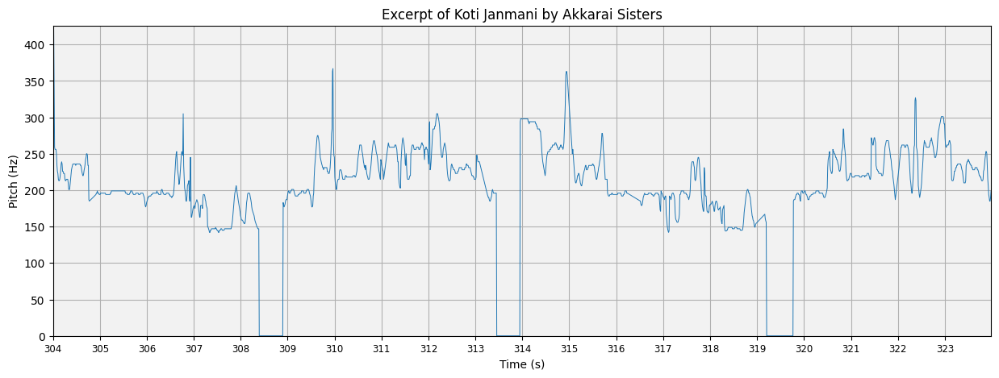

In [40]:
plot_pitch(this_pitch, this_time, title=f'Excerpt of {title} by {name}')
ipy_audio(audio, t1, t2, sr=sr)

The plot is OK but we could definitely make it more interpretable. First of all, since silences are represented as 0Hz in our predominant pitch track, the interpolation between points creates large drops to 0 for these regions. We can pass a binary mask to `plot_pitch` to tell it not to plot certain areas. In this case we want this mask to be 1 when there is non-silence (non-zero) and 1 otherwise:

In [41]:
silence_mask = this_pitch==0

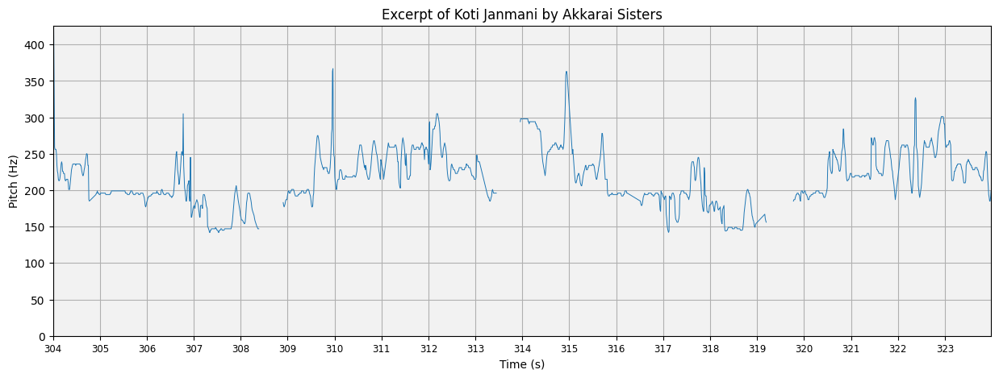

In [42]:
plot_pitch(this_pitch, this_time, mask=silence_mask, title=f'Excerpt of {title} by {name}')
ipy_audio(audio, t1, t2, sr=sr)

Pitch is often thought about in terms of it's relationship to the tonic (Sa), which we can quantify using cents. A tonic identifier is provided in `compiam.melody`, or alternatively the tonic may be provided precomputed in the Saraga Dataset.

In [43]:
from compiam.melody import tonic_identification

In [44]:
#tonicExt = tonic_identification.TonicIndianMultiPitch()
tonic = 195.99

Passing this tonic to `plot_pitch` converts the plotted curve to cents

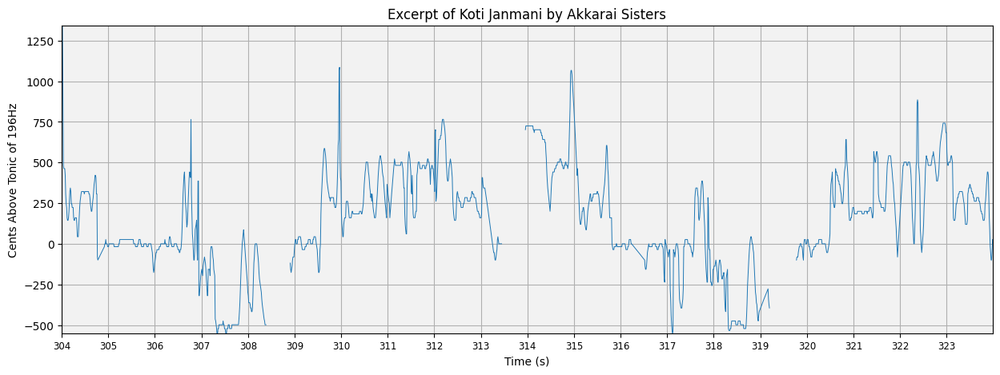

In [45]:
plot_pitch(this_pitch, this_time, mask=silence_mask, tonic=tonic, cents=True, title=f'Excerpt of {title} by {name}')
ipy_audio(audio, t1, t2, sr=sr)

Finally we go one step further and replace the cents ticks on the y-axis with the expected svaras for this raga, plotted at their theoretical pitch positions on an equal tempered scale. 

For a growing list of ragas, these theoretical svara:pitch mappings are available from `compiam.utils.get_svara_pitch_carnatic`.

In [46]:
from compiam.utils import get_svara_pitch_carnatic

It is not uncommon to observe variations in how raga names (and more broadly, Indian Art Music terms) are transliterated from their original Indian language to latin-script. This makes it difficult to create key value mappings using these terms. If an unknown raga is passed to `get_svara_pitch_carnatic`, a list of closest matches are suggested as alternatives (if any exists).

In [47]:
get_svara_pitch_carnatic(raga)

ValueError: Raga, Rītigauḷa not available in conf. Nearest matches: ['ritigaula']

Passing the tonic returns these pitches in Hz, else they are returned in cents:

In [48]:
svara_pitch = get_svara_pitch_carnatic('ritigaula', tonic=tonic)

In [49]:
svara_pitch

{87.30361988416256: 'N2',
 174.60723976832512: 'N2',
 349.21447953665023: 'N2',
 698.4289590733005: 'N2',
 1396.857918146601: 'N2',
 82.40364421278775: 'D2',
 164.8072884255755: 'D2',
 329.614576851151: 'D2',
 1318.458307404604: 'D2',
 73.4133009992652: 'P',
 146.8266019985304: 'P',
 293.6532039970608: 'P',
 587.3064079941216: 'P',
 659.229153702302: 'P',
 48.9975: 'S',
 97.995: 'S',
 195.99: 'S',
 391.98: 'S',
 783.96: 'S',
 65.40381575469627: 'M1',
 130.80763150939254: 'M1',
 261.6152630187851: 'M1',
 523.2305260375701: 'M1',
 1046.46105207514: 'M1',
 58.268175617345825: 'G2',
 116.53635123469165: 'G2',
 233.0727024693833: 'G2',
 466.1454049387666: 'G2',
 932.2908098775332: 'G2',
 54.997834212038505: 'R2',
 109.99566842407701: 'R2',
 219.99133684815402: 'R2',
 439.98267369630804: 'R2',
 879.965347392616: 'R2'}

`plot_pitch` accepts alternative y ticks in the format `y-values:label`.

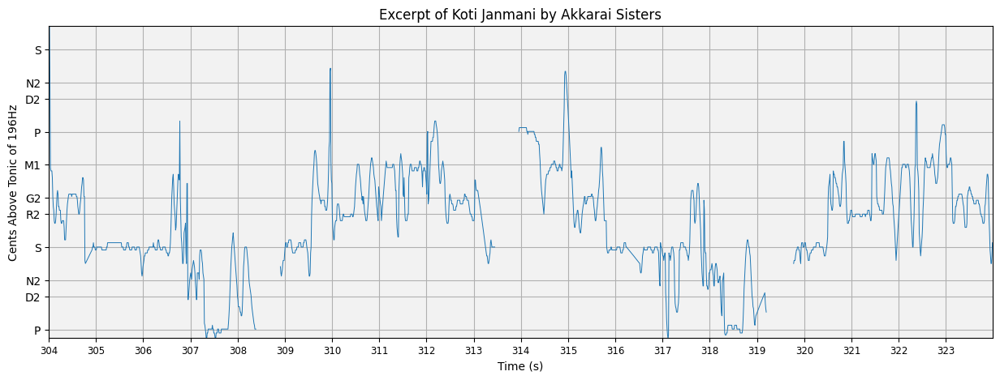

In [50]:
plot_pitch(this_pitch, this_time, mask=silence_mask, tonic=tonic, yticks_dict=svara_pitch, cents=True, title=f'Excerpt of {title} by {name}')
ipy_audio(audio, t1, t2, sr=sr)

It should be noted that Carnatic music does not use the equal tempered scale, and indeed that the same svara position, e.g., R2, may be deliberately placed slightly differently in different ragas. Therefore, any deviation here from those theoretical pitch positions does not indicate an error in intonation, but more likely reflects correct musical practice in the style or slight errors in the automated calculation of the tonic.
<a id='3.3'></a>

### 3.3 Introduction to pitch density plots
Pitch density plots represent the probability density function (PDF) of the continuous variable, pitch, across a series of observations. Here we achieve this using **kernel density estimation**.

**Kernel density estimation** is a non-parametric method of estimating the PDF of a continuous random variable.  It is non-parametric because it does not assume any underlying distribution for the variable.  Essentially, at every datum, a kernel function is created with the datum at its centre – this ensures that the kernel is symmetric about the datum.  The PDF is then estimated by adding all of these kernel functions and dividing by the number of data to ensure that it satisfies the 2 properties of a PDF:

1. Every possible value of the PDF (i.e. the function, f(x)), is non-negative.
2. The definite integral of the PDF over its support set equals to 1.

To **construct a kernel density estimate**:

1. Choose a kernel, here we use Gaussian (also popular are rectangular and triangular).

2. At each datum, $x_i$, build the scaled kernel function:

<center>$h^{-1}K[(x - x_i)/h]$</center>

where $K()$ is your chosen kernel function and $h$, the bandwidth.

3) Add all of the individual scaled kernel functions and divide by $n$; this places a probability of $1/n$ to each $x_i$. It also ensures that the kernel density estimate integrates to 1 over its support set.

<center>$\hat{f}(x) = n^{-1}h^{-1}\sum_{i=1}^{n}K[(x - x_i)/h]$</center>

**Intuitively**, a kernel density estimate is a sum of “bumps”.  A “bump” is assigned to every datum, and the size of the “bump” represents the probability assigned at the neighbourhood of values around that datum; thus, if the data set contains...

- 2 data at x = 250
- 1 datum at x = 430

...then the “bump” at x = 250 is twice as big as the “bump” at x = 430


Comparison of the histogram (left) and kernel density estimate (right) constructed using the same data. The six individual kernels are the red dashed curves, the kernel density estimate the blue curves. (Source: [Wikimedia Commons](https://en.wikipedia.org/wiki/Kernel_density_estimation#/media/File:Comparison_of_1D_histogram_and_KDE.png)):

<div>
<figure>
<img src="../images/KDE.png" width="500"/>
</figure>
</div>

Each “bump” is centred at the datum, and it spreads out symmetrically to cover the datum’s neighbouring values.  Each kernel has a bandwidth, and it determines the width of the “bump” (the width of the neighbourhood of values to which probability is assigned).  A bigger bandwidth results in a shorter and wider “bump” that spreads out farther from the centre and assigns more probability to the neighbouring values.

The most important parameter is the **bandwidth**, $h$. A useful guideline in selecting this value is

- A small bandwidth results in a small standard deviation, and the kernel places most of the probability on the datum.  Use this when the sample size is large and the data are tightly packed.
- A large bandwidth results in a large standard deviation, and the kernel spreads more of the probability from the datum to its neighbouring values.  Use this when the sample size is small and the data are sparse.

Pitch distributions have proven useful in MIR tasks for IAM...

- Raga and tonic identification - [Samsekai Manjabhat, S., et al. "Raga and tonic identification in carnatic music." Journal of New Music Research 46.3 (2017): 229-245.](https://link.springer.com/article/10.1007/s00521-018-3849-7)
- Segmentation/melodic pattern discovery - [Gulati, Sankalp, et al. "Landmark detection in hindustani music melodies." Georgaki A, Kouroupetroglou G, eds. Proceedings of the 2014 International Computer Music Conference, ICMC/SMC; 2014](https://repositori.upf.edu/handle/10230/35683)

and likewise in supporting musicological discussion...

- Analysis rāga ālāpana [Viswanathan, Tanjore. "The analysis of rāga ālāpana in South Indian music." Asian Music (1977): 13-71.](https://www.jstor.org/stable/833817)
- Intonation analysis - [Koduri, Gopala Krishna, Joan Serrà Julià, and Xavier Serra. "Characterization of intonation in carnatic music by parametrizing pitch histograms." Gouyon F, Herrera P, Martins LG, Müller M. ISMIR 2012: Proceedings of the 13th International Society for Music Information Retrieval Conference; 2012](https://repositori.upf.edu/bitstream/handle/10230/22728/Koduri_ISMIR_2012.pdf?sequence=1&isAllowed=y)


(Text adapted from *[Exploratory Data Analysis: Kernel Density Estimation – Conceptual Foundations - Eric Cai](https://chemicalstatistician.wordpress.com/2013/06/09/exploratory-data-analysis-kernel-density-estimation-in-r-on-ozone-pollution-data-in-new-york-and-ozonopolis/)*)
<a id='3.4'></a>

### 3.4 Pitch density extraction
The `get_pitch_density()` function in `compiam.visualisation.pitch` returns a density plot of the input array, specifically formatted for the context of pitch. 

#### A single example
Let's us take a look at the pitch density plot for our chosen performance. Seaborn provides a kernel density estimation plotter.

In [51]:
import seaborn as sns

We want to investigate pitch as measure in cents above the tonic. There is a converter in `compiam.utils.pitch`

In [52]:
from compiam.utils.pitch import pitch_seq_to_cents

In [53]:
pitch_cents = pitch_seq_to_cents(pitch, tonic=tonic)

Silences are represented by Nones, we must remove those

In [54]:
import numpy as np
p = pitch_cents[pitch_cents != np.array(None)]

Computing and plotting with seaborn

In [55]:
import matplotlib.pyplot as plt

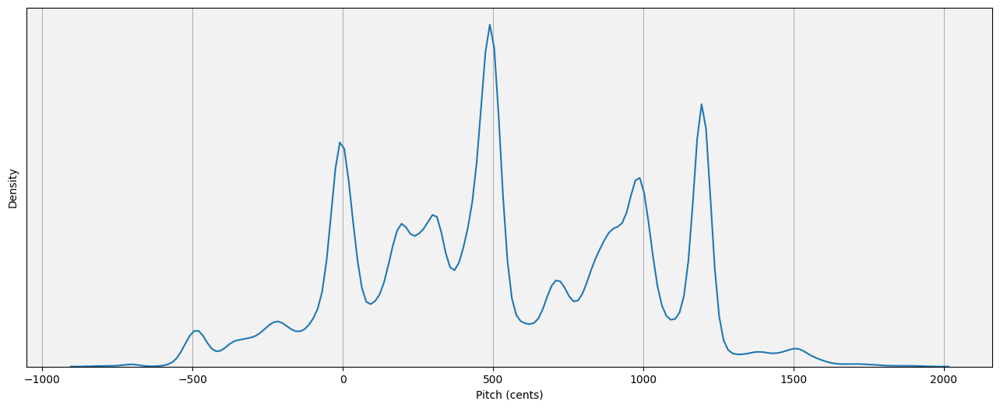

In [56]:
# One octave... shouldn't need to specify
# plot setup
plt.figure(figsize=(16,6))
plt.grid()

# plot background colour
ax = plt.gca()
ax.set_facecolor('#f2f2f2')

# turn off y ticks
plt.yticks([], [])

# Axis labels
plt.ylabel('Density')
plt.xlabel(f'Pitch (cents)')

# Plot using seaborn
spltp = sns.kdeplot(p, bw_method=0.05)

# store data
unfolded_data = spltp.lines[0].get_xydata()

Force to one octave

In [57]:
p1 = p%1200

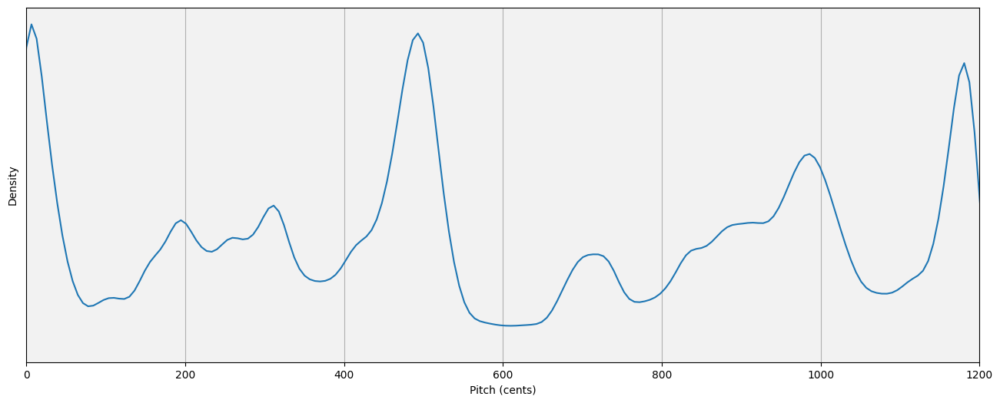

In [58]:
# One octave... shouldn't need to specify
# plot setup
plt.figure(figsize=(16,6))
plt.grid()

ax = plt.gca()
ax.set_facecolor('#f2f2f2')

# turn off y ticks
plt.yticks([], [])

plt.ylabel('Density')
plt.xlabel(f'Pitch (cents)')

plt.xlim((0,1200))

spltp1 = sns.kdeplot(p1, bw_method=0.04)

Add svara theoretical pitch positions

In [61]:
svara_pitch_cents = get_svara_pitch_carnatic('ritigaula')

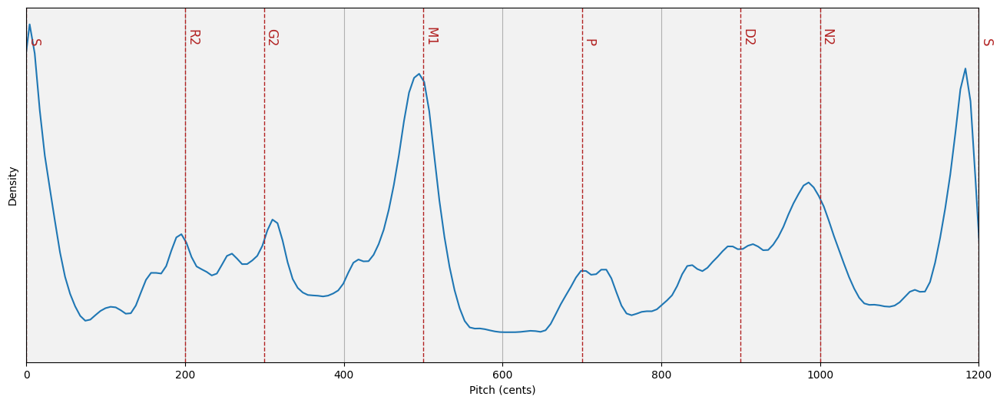

In [62]:
# One octave... shouldn't need to specify
# plot setup
plt.figure(figsize=(16,6))
plt.grid()

ax = plt.gca()
ax.set_facecolor('#f2f2f2')

# turn off y ticks
plt.yticks([], [])

plt.ylabel('Density')
plt.xlabel(f'Pitch (cents)')

plt.xlim((0,1200))

spltp1 = sns.kdeplot(p1, bw_method=0.03)

# Get max value in y
y_max = spltp1.get_ylim()[1]

for k,v in svara_pitch_cents.items():
    # just svaras for this octave
    if 0 <= k <= 1200:
        plt.axvline(k, color="firebrick", linestyle="--", linewidth=1)
        plt.text(k, y_max - y_max*0.1, v, color="firebrick", fontsize=12, rotation=270)

Looks good right? Any problems?

There are two peaks for Sa, neither correponding exactly to the tonic (0 cents). This is unexpected. When we look at the pitch plot computed across all octaves we do not see two peaks for Sa!

This is not an error, everything is functioning as it should do. But in aggregating the individual kernel functions (the bumps), each peak is effected by all bumps in it's neighbourhood, in the unfolded plot the Sa peak has a neighbourhood to it's left and to it's right. In the folded plot it only has a neighbourhood to one side depending on whether we are looking at pitch=0, pitch=1200. If we look at the KDE, histogram comparison figure again we can see this


<div>
<figure>
<img src="../images/KDE.png" width="500"/>
</figure>
</div>

Pick a y value corresponding to a peak and imagine the line x=(this y value). You should see that red kernel functions from both sides of this line contribute to the aggregated density estimation (blue line). This is not the case when all data points on one side of the line are removed (such as is the case for when folding pitch values to one octave).

#### Fixing tonic errors in folded plots
To fix this issue we must compute the pitch density plot across all octaves and *then* aggregate. Let's take the data from our unfolded plot

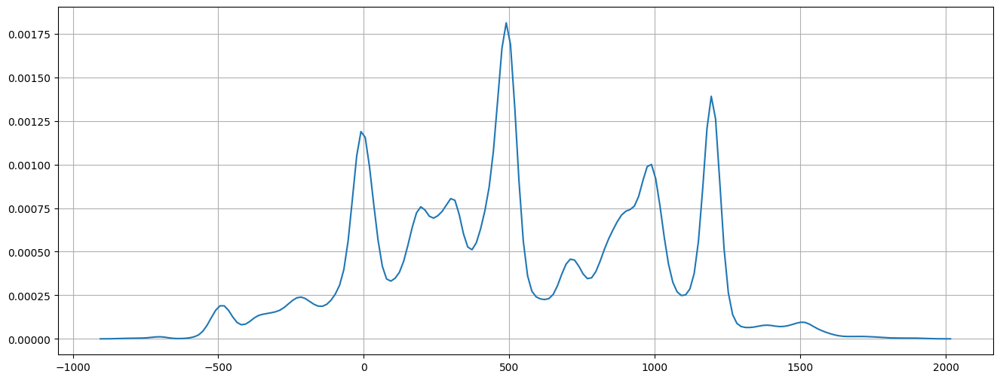

In [63]:
plt.figure(figsize=(16,6))
plt.grid()
plt.plot(unfolded_data[:,0], unfolded_data[:,1])

And now split plot into three sections, one for each octave

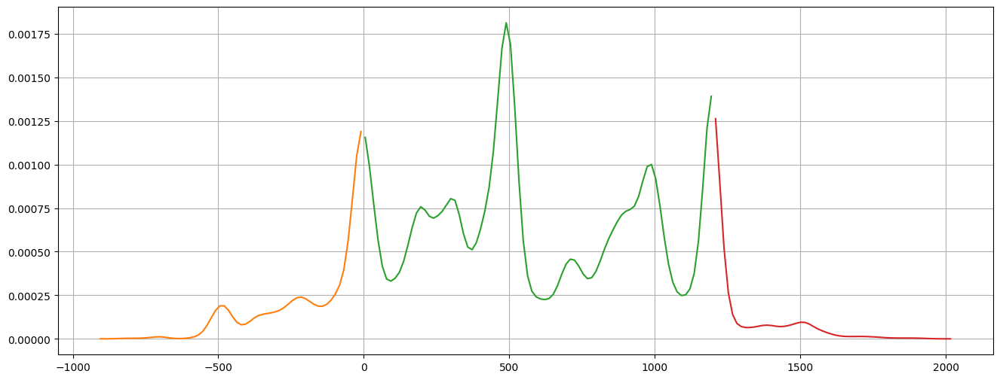

In [64]:
data_sep = []
plt.figure(figsize=(16,6))
plt.grid()
# Divide cent data into ocataves
for i in np.arange(-2400, 2400, 1200):
    mask = (unfolded_data[:,0]>=i) & (unfolded_data[:,0]<i+1200)
    this_data = unfolded_data[mask]
    plt.plot(this_data[:,0], this_data[:,1])
    data_sep.append(this_data)

Force each section to the 0cents -> 1200cents octave

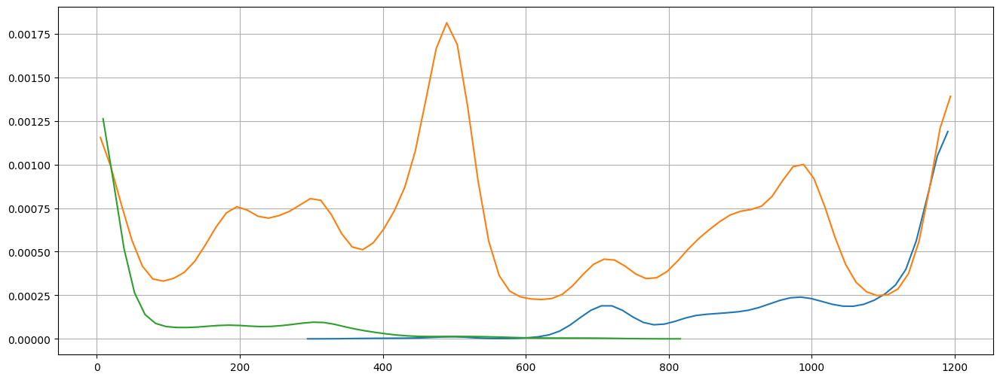

In [65]:
# Force to same octave
data_octave = []
plt.figure(figsize=(16,6))
plt.grid()
for d in data_sep:
    if d.any():
        d[:,0] = d[:,0]%1200 # force to same octave
        data_octave.append(d)
        plt.plot(d[:,0], d[:,1])

Since each of these lines do not necessarily terminate at exactly 0 and 1200. If we sum them we will observe big discrepancies in pitch towards these limits:

In [66]:
# Sum distributions using interpolation
def sum_dist(d1, d2):
    """
    Sum two distributions, <d1> and <d2> along y axis
    
    :param d1,d2: numpy array of form [(x, y),...
    :type d1,d2: np.array
    
    :returns: one array with y values summed
    :rtype: np.array
    """
    if not d1.any():
        return d2
    elif not d2.any():
        return d1
    elif (not d1.shape[1] == 2) or (not d2.shape[1] == 2):
        raise ValueError("Arrays must have two columns")
        
    x1 = d1[:,0]
    y1 = d1[:,1]

    x2 = d2[:,0]
    y2 = d2[:,1]

    # get a sorted list of all x values
    x = np.unique(np.concatenate((x1,x2)))

    # interpolate y1 and y2 on the combined x values
    yi1 = np.interp(x, x1, y1, left=0, right=0)
    yi2 = np.interp(x, x2, y2, left=0, right=0)
    
    y = yi1 + yi2
        
    return np.array([x,y]).T

In [67]:
summed_d = np.empty((0,2))
for d in data_sep:
    summed_d = sum_dist(summed_d, d)

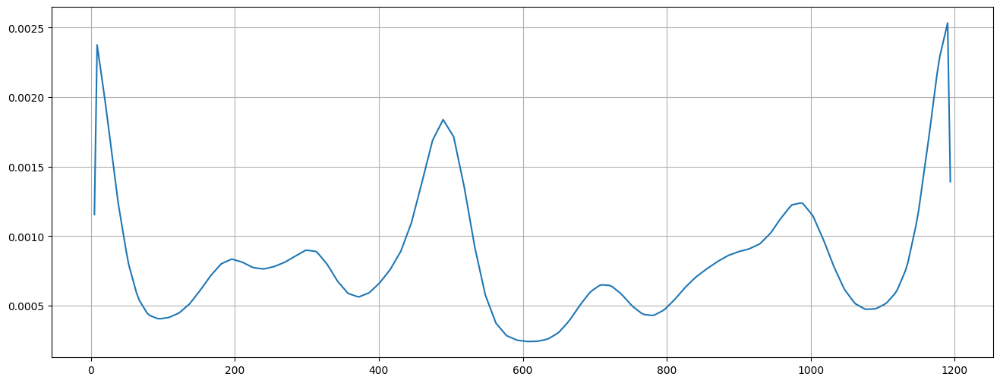

In [68]:
plt.figure(figsize=(16, 6))
plt.grid()
plt.plot(summed_d[:,0], summed_d[:,1])

To avoid this we must ensure that each series terminates at exactly 0 and 1200 cents

In [69]:
from numpy.linalg import lstsq

def line_through_points(x0, y0, x1, y1):
    """
    Return two functions corresponding to straight line learnt 
    via least squares regression between two points (x0,y0)
    and (x1, y1). These functions retrieve x and y values 
    from that line.
    
    :param x0,y0,x1,y1: coordinates values corresponding to two points
    :type x0,y0,x1,y1: float

    :returns: Two lambda functions, get_x and get_y that takes as a value, y or x
        respectively and returns x or y values along learnt line
    :rtype: two python functions
    """
    points = [(x0, y0), (x1, y1)]
    x_coords, y_coords = zip(*points)
    
    # gradient and intercecpt of line passing through centroids
    A = np.vstack([x_coords, np.ones(len(x_coords))]).T
    m, c = lstsq(A, y_coords, rcond=None)[0]

    # functions for converting between
    # x and y on that line
    get_y = lambda xin: m*xin + c
    get_x = lambda yin: (yin - c)/m

    return get_x, get_y

In [70]:
#extend to same start and end point
data_extended = []
for d in data_octave:
    # line through first 5 points
    first_point = d[0]
    second_point = d[5]
    getx_min, gety_min = line_through_points(
        first_point[0], first_point[1], second_point[0], second_point[1])

    # line through final 5 points
    final_point = d[-1]
    penultimate_point = d[-6]
    gety_max, gety_max = line_through_points(
        final_point[0], final_point[1], penultimate_point[0], penultimate_point[1])

    # new point at x=0
    new_point1 = np.array([0, gety_min(0)])

    # new point at x=1200
    new_point2 = np.array([1200, gety_max(1200)])

    # append at beginning
    d = np.concatenate([[new_point1], d])
    # append at end
    d = np.concatenate([d, [new_point2]])

    data_extended.append(d)        

Overlaid extended lines...

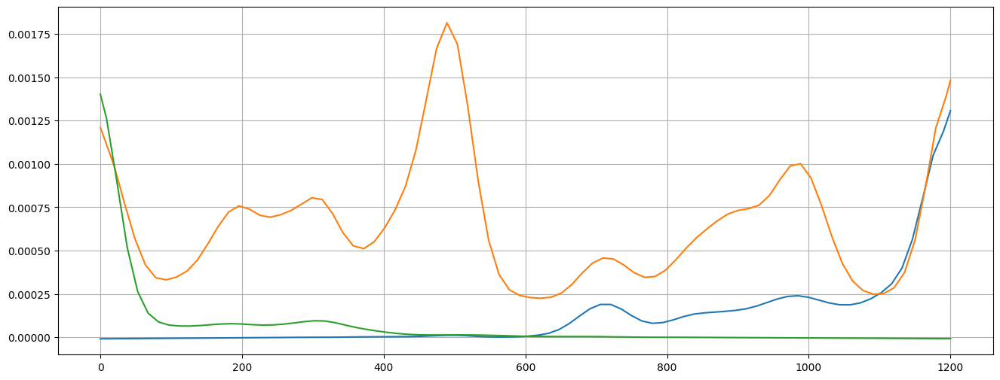

In [71]:
plt.figure(figsize=(16,6))
plt.grid()
for d in data_extended:
    plt.plot(d[:,0], d[:,1])

Summing all together

In [72]:
summed_d = np.empty((0,2))
for d in data_extended:
    summed_d = sum_dist(summed_d, d)

And finally we must normalise so the area under the curve sums to one

In [73]:
# normalise area under curve to equal 1
summed_d[:,1] /= summed_d[:,1].sum()

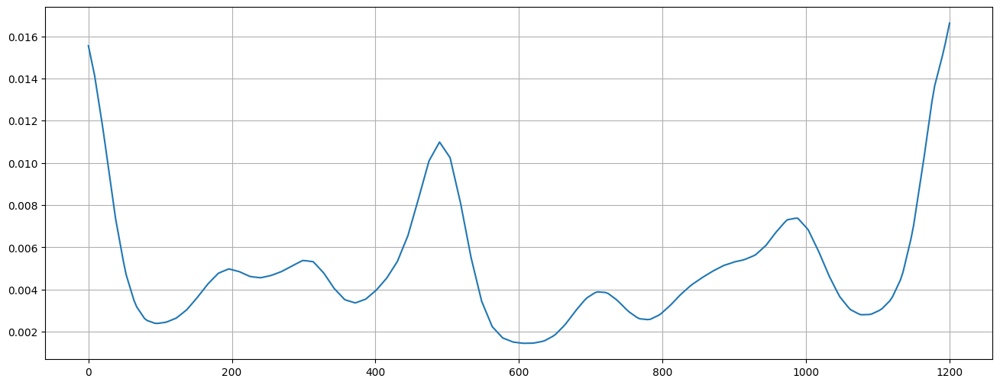

In [74]:
plt.figure(figsize=(16, 6))
plt.grid()
plt.plot(summed_d[:,0], summed_d[:,1])

An implementation for this folded and unfolded pitch density computation is provided at `compiam.visualisation.pitch.get_pitch_density`

In [75]:
flush_matplotlib() # clear all background plots

<Figure size 640x480 with 0 Axes>

#### Extraction across the datastet
Now that we are able to compute reliable pitch density plots let's explore pitch density across a sample of the dataset.

For all performances across a sample of ragas in the Saraga dataset we:
1. Compute the predominant pitch tracks extracted using the Carnatic FTA-Net model
2. Convert pitch track to cents using `compiam.utils.pitch.pitch_seq_to_cents()` using the tonic provided as part of the saraga dataset. If the tonic is not present we use `compiam.melody.tonic_identification()` to predict it.
3. Combine all pitch tracks corresponding to each raga
4. Get svara:cents mappings for each raga using `compiam.utils.get_svara_pitch_carnatic()`
5. Get and compute the pitch histogram using `compiam.visualisation.pitch.get_pitch_density()`. (Setting `octave=True` forces all pitches to the same octave). Overlay theoretical pitch positions of svaras relevant to each raga and display all plots. 

In [76]:
from compiam.visualisation.pitch import get_pitch_density
from compiam.utils.pitch import pitch_seq_to_cents
from compiam.melody import tonic_identification
from compiam.utils import get_svara_pitch_carnatic

import numpy as np
import tqdm

Let's define some basic functions for getting and processing the data

In [77]:
from compiam.utils import create_if_not_exists

def get_audio_path(track_id, track_data):
    """
    For saraga <track_id>, return path of vocal source.
    If isolated vocal source does not exist for track,
    return path to mixed audio.
    """
    data = track_data[track_id]
    
    vocal_path = data.audio_vocal_path
    audio_path = data.audio_path
    
    return audio_path if not vocal_path else vocal_path

def extract_pitch_track(path):
    """
    Extract predominant pitch track of audio at
    <path>. Return pitch, time and timestep
    """
    pitch_track = ftanet.predict(path)
    pitch = pitch_track[:,1]
    time  = pitch_track[:,0]
    timestep  = time[2]-time[1]
    return pitch, time, timestep

def save_pitch_track(time, pitch, path):
    """
    Save pitch track as tsv to <path>
    format: (time, pitch)
    """
    create_if_not_exists(path)
    with open(path,'w') as file:
        for t, p in zip(time, pitch):
            file.write(f"{t}\t{p}")
            file.write('\n')

def load_pitch_track(path):
    """
    Load pitch track from tsv to
    format: (time, pitch)
    """
    pitch = []
    time = []
    with open(path, 'r') as f:
        for i in f:
            t, f = i.replace('/n','').split('\t')
            pitch.append(float(f))
            time.append(float(t))
    timestep = time[3]-time[2]
    return np.array(pitch), np.array(time), timestep

#### Extracting predominant pitch tracks
We extract the predominant pitch track for a sample of popular ragas. Each is a raga for which we have more than one recording in the Saraga Dataset.

<font color='red'>**Warning!**</font> The following snippet as it stands can take a lot of time (extracting pitch tracks for ~30 tracks). Changing the number of ragas in `sample_raga` will affect this. For the online notebook the lines `# Extract pitch track` and `# Save locally` are commented out and the results cached beforehand. Remember to uncomment these lines if you want to extract these yourself or include different ragas/tracks.

In [78]:
# sample of most common abundant ragas in Saraga Dataset
sample_ragas = [
    'Tōḍi',
    'Kamās',
    'Saurāṣtraṁ',
    'Bhairavi',
    'Rītigauḷa'
]

# Save pitch tracks to local directory
pitch_dir = './pitch_data/'

In [82]:
import os

# dict of data relating to each raga
raga_track = {r:{"pitch_paths":[],"tonics":[],"names":[],"track_ids":[]} for r in sample_ragas}

# Iterate through track data, extract pitch track, save locally
for t, data in track_data.items():
    
    raga = data.metadata["raaga"]   
    if raga:
        # raga annotation is sometimes None
        raga = raga[0]["name"]
        
    if raga in sample_ragas:
        # Get audio path
        path = get_audio_path(t, track_data)
    
        # Extract pitch track
        #pitch, time, timestep = extract_pitch_track(path)
        
        # Save locally
        out_path = os.path.join(pitch_dir, f"{t}.csv")
        #save_pitch_track(time, pitch, out_path)

        # Metadata
        artist = data.metadata["album_artists"][0]["name"]
        title = data.metadata["title"]
        tonic = data.tonic
        
        # Update Dict
        raga_track[raga]["track_ids"] += [t]
        raga_track[raga]["pitch_paths"] += [out_path]
        raga_track[raga]["tonics"] += [tonic]
        raga_track[raga]["names"] += [f"{artist} - {title}"]

#### Pitch density extraction

In [83]:
# map saraga names to names in local dictionary
raga_norm = {
    "Tōḍi": "todi", 
    "Kamās": "kamas", 
    "Saurāṣtraṁ": "saurastram", 
    "Bhairavi": "bhairavi", 
    "Rītigauḷa": "ritigaula"
}

In [84]:
pitch_hists = {} # dict to store histogram data

In [85]:
for r, d in raga_track.items():
    print(f"Processing: {r}")
    # get performances for rāga
    pitch_paths = d["pitch_paths"]
    tonics = d["tonics"]
    names = d["names"]
    track_ids = d["track_ids"]
    normalised_name = raga_norm[r]
    
    # number of examples
    nr = len(pitch_paths)
    
    all_pitch = np.array([])
    all_hists = []
    for i in range(len(pitch_paths)):
        pitch_path = pitch_paths[i]
        tonic = tonics[i]
        name = names[i]
        track_id = track_ids[i]
        
        # 1. Load precomputed pitch track
        pitch, time, timestep = load_pitch_track(pitch_path)
        
        # 2. Convert to cents
        if not tonic:
            tonicExt = tonic_identification.TonicIndianMultiPitch()
            tonic = tonicExt.extract(pitch)
         
        pitch_cents = pitch_seq_to_cents(pitch, tonic=tonic)
        
        # 3. combine pitch tracks
        all_pitch = np.concatenate([all_pitch, pitch_cents])
        
        # 4. Get svara:cents mapping
        svara_map = get_svara_pitch_carnatic(normalised_name)
        
        # 5. Compute pitch histograms
        ph = get_pitch_density(pitch_cents, title=name+f" ({r})", bw=0.035, annotations=svara_map, octave=True, cents=True, imode=False)
        
        # store individual pitch histograms
        all_hists.append(ph)
        
        flush_matplotlib()
    
    # Store combined pitch histograms
    ph = get_pitch_density(all_pitch, title=f'{r} from {nr} performances', bw=0.02, annotations=svara_map, octave=True, cents=True, imode=False)
    all_hists.append(ph)
    flush_matplotlib()
    pitch_hists[r] = all_hists


Processing: Tōḍi
Processing: Kamās
Processing: Saurāṣtraṁ
Processing: Bhairavi
Processing: Rītigauḷa


<Figure size 640x480 with 0 Axes>

Write all pitch histograms to folder (replace `<out_dir>`)

In [87]:
if False: # skipping for now
    out_dir = '<out_dir>'

    for r, plots in pitch_hists.items():
        for i, p in enumerate(plots):
            title = p.title.get_text()
            if i == len(plots)-1:
                out_path = os.path.join(out_dir, r, f"{r}_combined.png")
            else:
                out_path = os.path.join(out_dir, r, title)
            create_if_not_exists(out_path)
            print(f'Saving, {out_path}')
            p.figure.savefig(out_path.replace('.',''))

<a id='3.5'></a>

### 3.5 Pitch density across rāga
Let's take a moment to consider some of these results. Rāga rītigauḷa and bhairavi share many of the same svaras...

In [88]:
ritigaula_svaras = get_svara_pitch_carnatic("ritigaula") # svaras for ritigaula
bhairavi_svaras = get_svara_pitch_carnatic("bhairavi") # svaras for bhairavi
print(f"Rītigauḷa: {set(ritigaula_svaras.values())}")
print(f"Bhairavi: {set(bhairavi_svaras.values())}")

Rītigauḷa: {'N2', 'D2', 'P', 'S', 'M1', 'G2', 'R2'}
Bhairavi: {'N2', 'D1', 'D2', 'P', 'S', 'M1', 'G2', 'R2'}


We expect our pitch histograms to corroborate this...

In [89]:
ritigaula = pitch_hists["Rītigauḷa"][-1]
bhairavi = pitch_hists["Bhairavi"][-1]

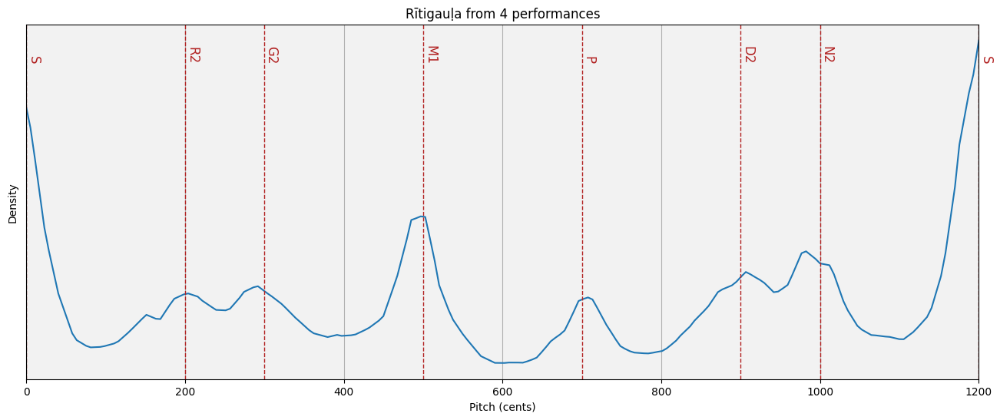

In [90]:
ritigaula.figure

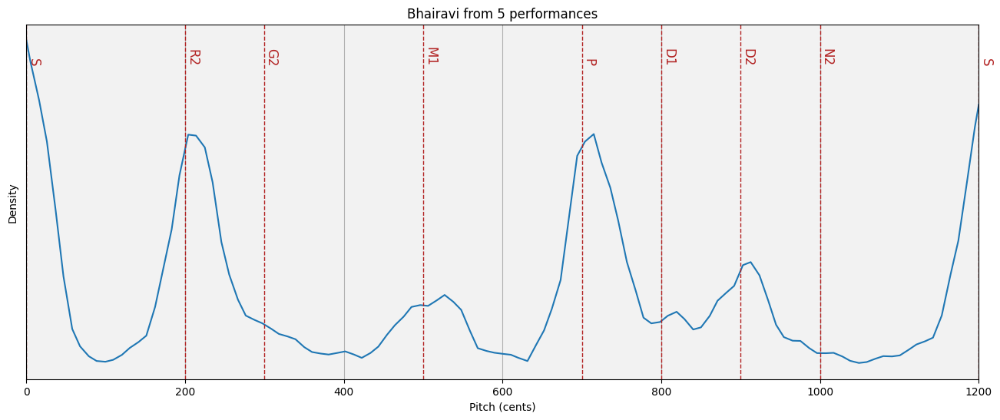

In [91]:
bhairavi.figure

There are several interesting differences to note in this comparison. The two rāgas share mostly the same svaras, apart from the fact that in these versions of rītigauḷa (although not all versions) there is no D1, while in bhairavi D1 is there.
We can see from these two combined plots that ri is stronger in bhairavi than in rītigauḷa, which indeed reflects typical performance practice. In addition, we can see a small but clear peak for N2 in rītigauḷa that is not present in bhairavi. This is most likely because rītigauḷa includes a frequently performed characteristic phrase in which a relatively plain ni features strongly, while in bhairavi, ni is much more frequently performed as an oscillation between dha and sa.

Again it is worth iterating here that the pitch positions shown as red dotted lines together with the svara indications S, R2, G2 etc., are only indicative of positions on an equal tempered scale and that Carnatic music does not use the equal tempered scale. Therefore, any deviation here from those dotted lines does not indicate an error in intonation, but more likely reflects correct musical practice in the style or slight errors in the automated calculation of the tonic.
<a id='3.6'></a>

### 3.6 Pitch density as a feature
The form of the pitch histogram gives us a sort of pitch fingerprint of the rāga or performance it describes. Since they are normalised in the y-dimension (density plots) and in the x-dimension (cents), comparison between them is easy, regardless of how many performances have contributed to their creation.

We compute the distance between each pairwise combination of performance pitch histogram, using cross entropy (other measures are perfectly valid!).

In [92]:
def dist_measure(d1, d2, measure=lambda y1,y2: -np.sum(y1 * np.log(y2))):
    """
    Compute measure between distributions d1 and d2 using <measure>. 
    Default: cross entropy
    
    :param d1, d2: distributions of form [(x,y),..
    :param d1, d2: np.array
    :param measure: function that takes two distributions y-values and returns some measure, metric or distance
    :param measure: python function
    
    :returns: value, from <measure>
    :rtype: float
    """
    # Ensure distributions have same x values
    x1 = d1[:,0]
    y1 = d1[:,1]

    x2 = d2[:,0]
    y2 = d2[:,1]

    # get a sorted list of all x values
    x = np.unique(np.concatenate((x1,x2)))

    # interpolate y1 and y2 on the combined x values
    yi1 = np.interp(x, x1, y1, left=0, right=0)
    yi2 = np.interp(x, x2, y2, left=0, right=0)
    
    # downsample
    yi1 = yi1[0:yi1.size:2]
    yi2 = yi2[0:yi2.size:2]
    
    return measure(yi1, yi2)

In [93]:
# Get unique performance names
performance_names = [[h.title.get_text() for h in hists[:-1]] for hists in pitch_hists.values()] 
performance_names = [y for x in performance_names for y in x]

# get individual performance histograms
performance_histograms = [[h for h in hists[:-1]] for hists in pitch_hists.values()]
performance_histograms = [y for x in performance_histograms for y in x]

# get data corresponding to y-axis
performance_hist_data = [h.lines[0].get_xydata() for h in performance_histograms]

In [94]:
# iterate through all performances and compute pairwise distance
# updating distance matrix
n = len(performance_names)
performance_dist_matrix = np.zeros((n,n))
for i in range(n):
    for j in range(i, n):
        performance_dist_matrix[i,j] = dist_measure(performance_hist_data[i], performance_hist_data[j])
        performance_dist_matrix[j,i] = performance_dist_matrix[i,j] 

<a id='3.7'></a>

### 3.7 Performance clustering
In fact, we can take a naive look at to what extent svara realization is able to distinguish between rāgas using the information captured by the pitch density plots.

Let's apply a hierarchical clustering algorithm using the pairwise cross entropy distances between performances as the affinity.

In [95]:
from sklearn.cluster import AgglomerativeClustering

model = AgglomerativeClustering(affinity='precomputed', n_clusters=len(sample_ragas), linkage='complete').fit(performance_dist_matrix)
results_dict = {n:[] for n in range(len(sample_ragas))}
for i,l in enumerate(model.labels_):
    results_dict[l].append(f"{i}. "+performance_names[i])

In [96]:
for i,perfs in results_dict.items():
    print(f'Group {i+1}')
    for p in perfs:
        print(f"   {p}")

Group 1
   9. Sanjay Subrahmanyan - Payum Oli Nee Yenakku (Kamās)
   11. Sanjay Subrahmanyan - Karupuram Naarumo (Kamās)
   12. Kuldeep Pai - Brochevarevarura (Kamās)
   13. Rithvik Raja - Seetapati Namanasuna (Kamās)
   22. Sanjay Subrahmanyan - Kamakshi (Bhairavi)
   23. Sanjay Subrahmanyan - Sri Raghuvara Sugunaalaya (Bhairavi)
   24. Srividya Janakiraman - Nee Sari evvaramma (Bhairavi)
   29. Sumithra Vasudev - Vanajaksha Ninne Kori (Rītigauḷa)
Group 2
   0. Ashwath Narayanan - Eranapai (Tōḍi)
   1. Vasundara Rajagopal - Munnu Ravana (Tōḍi)
   2. Kanakadurga Venkatesh - Koluvamaregatha (Tōḍi)
   4. Cherthala Ranganatha Sharma - Karuna Nidhi Illalo (Tōḍi)
   5. Kuldeep Pai - Thappi Bratikipova (Tōḍi)
Group 3
   3. Sanjay Subrahmanyan - Eranapai (Tōḍi)
   6. Rithvik Raja - Emani Migula (Tōḍi)
   7. Ashwath Narayanan - Marubari (Kamās)
   8. Sanjay Subrahmanyan - Teerthakarayinile (Kamās)
   10. Sanjay Subrahmanyan - Sarasadalanayana (Kamās)
Group 4
   14. Vignesh Ishwar - Pavamana Su

We can see from these groupings that pitch is helpful, but not sufficient for differentiating rāgas. This is something that musicians know well. To better understand rāga performance we need to look also at the motif and phrase level, that is to say, the melody.
<a id='4'></a>

## 4. Melodic pattern analysis
Another important feature of the style is the structural and expressive significance of motifs and phrases known as sañcāras, which can be defined as coherent segments of melodic movement that follow the grammar of the rāga [4, 11]. These melodic patterns are the means through which the character of the rāga is expressed and form the basis of various improvisatory and compositional formats in the style [5, 11]. There exists no definitive lists of all possible sañcāras in each rāga, rather the body of existing compositions and the living oral tradition of rāga performance act as repositories for that knowledge [12].

Certain characteristics of Carnatic Music (some of which it shares with many traditions around the world) make the task of identifying repeated motifs and phrases in Carnatic music performances particuarly difficult, particularly in how certain motifs and phrases are often performed across occurrences with variations in tempo, pitch and ornamentation.

We return to Koti Janmani for the pattern analysis

In [97]:
track_id = '47_Koti_Janmani' 
track = track_data[track_id]

In [98]:
audio_path = track.audio_vocal_path
tonic = track.tonic

In [101]:
# This should have been extracted earlier in "extracting predominant pitch tracks"
pitch, time, timestep = load_pitch_track(os.path.join(pitch_dir, f"{track_id}.csv"))

In [102]:
pitch = interpolate_below_length(
    pitch, # track to interpolate
    0, # value to interpolate 
    350*0.001/timestep # maximum gap in number sequence elements to interpolate for
)

pitch_cents = pitch_seq_to_cents(pitch, tonic=tonic)


<a id='4.1'></a>

### 4.1 Melodic feature extraction
To identify repeated melodic patterns in our audio we use melodic features computed for windows across the entirety of the track and use the pairwise similarity between these to identify regions of consistent high-similarity... in theory corresponding to melodic repetitions.

In principle, any set of features can be used in this section. The extent to which these features capture the aspects of melody we care about will define their usefulness for the task.

Here we use melodic features extracted using a Complex Autoencoder (CAE). Mapping signals onto complex basis functions learnt by the CAE results in a magnitude space that has proven to achieve state-of-the-art results in repeared section discovery for audio [13].

The CAE we use here is provided via `compiam.load_models` and has been trained on the entirety of the Carnatic Saraga dataset for which we have multitrack recordings.

In [103]:
# Pattern Extraction for a Given Audio
from compiam import load_model

# Feature Extraction
# CAE features
cae = load_model("melody:cae-carnatic")

Extracting features across the entirety of our chosen audio...

In [104]:
# returns magnitude and phase
ampl, _ = cae.extract_features(audio_path)
ampl

loading file /Volumes/Shruti/data/mir_datasets/saraga_carnatic/saraga1.5_carnatic/Akkarai Sisters at Arkay by Akkarai Sisters/Koti Janmani/Koti Janmani.multitrack-vocal.mp3


/Users/thomasnuttall/.virtualenvs/compIAM/lib/python3.7/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


tensor([[0.6761, 0.8678, 0.7122,  ..., 0.3136, 0.2350, 0.9129],
        [0.7651, 0.8213, 0.8615,  ..., 0.3413, 0.3419, 0.8544],
        [0.7588, 0.5419, 0.7127,  ..., 0.1554, 0.2301, 0.9839],
        ...,
        [1.2637, 1.0545, 0.1310,  ..., 0.4503, 0.5424, 1.1163],
        [0.8967, 0.9673, 0.1438,  ..., 0.3844, 0.4324, 1.1706],
        [1.2442, 0.8481, 0.1906,  ..., 0.2542, 0.3391, 1.0519]],
       grad_fn=<PowBackward0>)

<a id='4.2'></a>

### 4.2 Self similarity
We want to compute the pairwsie self similarity between all combinations of features. With some Carnatic performances lasting up to over an hour, this can often be an expensive computation. There are many regions of the track that we are not interested in (such as silence), or that serve as plausible segmentation points for repeated melodic patterns (such as long periods of stability/silence). 

`compiam.melody.pattern.self_similarity` provides a method of computing the self similarity whilst skipping the computation for regions defined by a user specified exclusion mask.

In [105]:
from compiam.melody.pattern import self_similarity

First let's compute the mask corresponding to regions we do not want to compute, these are regions of silence:

In [106]:
silence_mask = pitch==0

And regions of consistent stability. To identify regions of consistent stability we use `compiam.utils.pitch.extract_stability_mask`. `extract_stability_mask` computes the average deviation of pitch from the mean in a series of windows across the track. If the deviation exceeds a certain threshold for a sufficient number of consecutive windows, the area is marked as stable (1 in the returned mask), else 0.

In [107]:
from compiam.utils.pitch import extract_stability_mask

In [108]:
stability_mask = extract_stability_mask(
    pitch=pitch_cents, # pitch track
    min_stab_sec=1.0, # minimum cummulative length of stable windows to warrant annotation
    hop_sec=0.2, # hop length in seconds
    var=60, # minimum variation from the mean in each window to be considered stable
    timestep=timestep # time in seconds between consecutice elements in <pitch>
)

We can inspect the result to check it has worked correctly

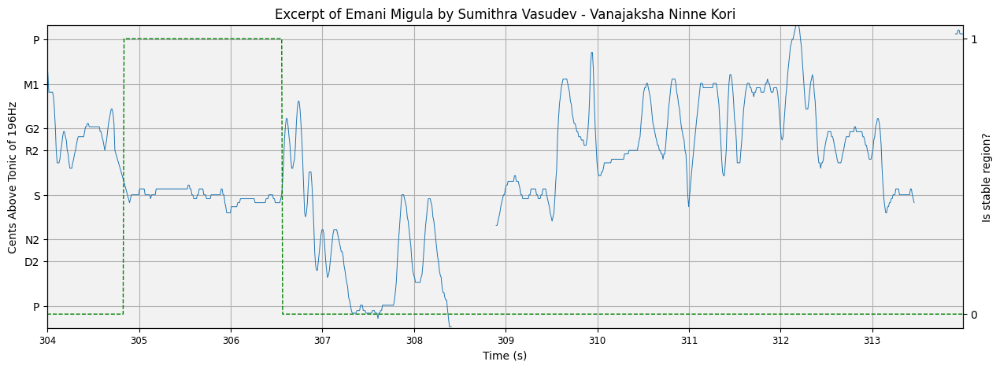

In [109]:
t1 = 304 # in seconds
t2 = t1 + 10 # in seconds

t1s = round(t1/timestep) # in sequence elements
t2s = round(t2/timestep) # in sequence elements

this_pitch = pitch[t1s:t2s]
this_time = time[t1s:t2s]
this_silence_mask = silence_mask[t1s:t2s]
this_stable_mask = stability_mask[t1s:t2s]

# get pitch plot
fig, ax = plot_pitch(this_pitch, this_time, mask=this_silence_mask, tonic=tonic, yticks_dict=svara_pitch, cents=True, title=f'Excerpt of {title} by {name}')

# On alternative axis plot stable mask values
ax2 = ax.twinx()
ax2.plot(this_time, this_stable_mask, 'g', linewidth=1, alpha=1, linestyle='--')
ax2.set_yticks([0,1])
ax2.set_ylabel("Is stable region?")
    
# accompanying audio
ipy_audio(audio, t1, t2, sr=sr)

Here the green line is to be read from the right-hand y-axis... is the region stable or not?

Looks good! Let's combine the two masks

In [110]:
import numpy as np
exclusion_mask = np.logical_or(silence_mask==1, stability_mask==1)

And compute the self similarity `self_similarity()`

In [111]:
# Mask of regions not interested in cite kaustuv, the papers that use 
ss = self_similarity(
    ampl, # features
    exclusion_mask=exclusion_mask, # exclusion mask
    timestep=timestep, # time in seconds between elements of exlcusion mask
    hop_length=cae.hop_length, # window size in audio frames
    sr=cae.sr # sample rate of audio
)

# Sparsely computed self similarity matrix 
X = ss[0]
# Mapping of index between theoretical full matrix and sparse one
orig_sparse_lookup = ss[1]
# Mapping of index between sparse matrix and theoretical full matrix one
sparse_orig_lookup = ss[2]
# Indices of boundaries between split regions in full matrix
boundaries_orig = ss[3]
# Indices of boundaries between split regions in sparse matrix
boundaries_sparse = ss[4]

How does the self similarity matrix look?

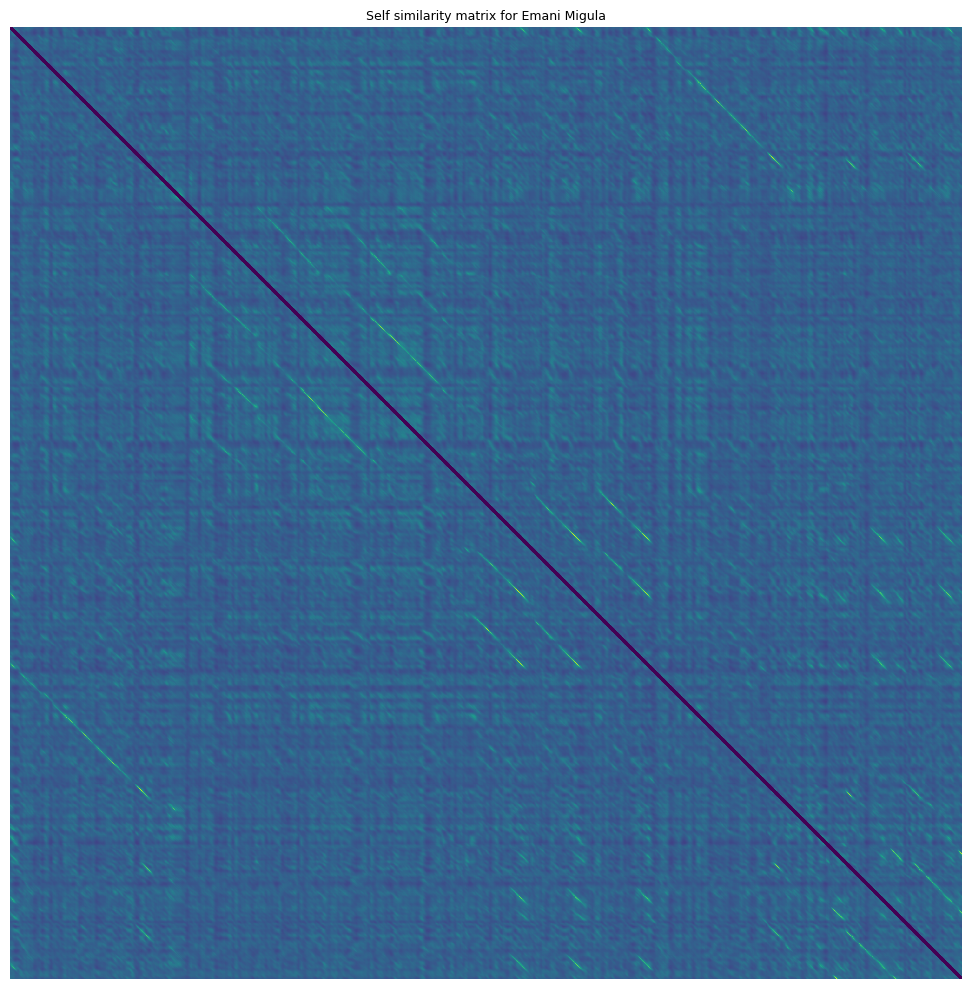

In [112]:
fig, ax = plt.subplots(figsize=(10,10))
plt.title(f'Self similarity matrix for {title}', fontsize=9)
ax.imshow(X[2000:5000,2000:5000], interpolation='nearest')
plt.axis('off')
plt.tight_layout()
plt.show()

<a id='4.3'></a>

### 4.3 Segment extraction
Diagonal segments in this self similarity matrix correspond to two regions of consistent high similarity (one on the x axis and y axis). We want to extract and define these segments.

Instances of the same sañcāra are often performed slightly differently. Tempo differences mean that the segments cannot be expected to be parallel to the y=x diagonal. Differences in ornamention or differences in elaboration (such as the insertion of additional svaras or gamakas) mean that segments are sometimes not completely consistent unbroken lines, terminating and ending at exactly the same place

To deal with extraction in this context we use the segment extractor at `compiam.melody.pattern.segmentExtractor` which is adapted from [12] and built specifically for the Carnatic Music context.

In [113]:
from compiam.melody.pattern import segmentExtractor

In [114]:
# Emphasize Diagonal
se = segmentExtractor(
    X, # self sim matrix
    window_size=cae.hop_length, # window size
    cache_dir='.cache/' # cache directory for faster computation in future
)

First we emphasize existing segments using a series of image processing techiniques:
- Convolution with a sobel filter to emphasize edges
- Normalise similarities to between 1 and 0
- Binarize matrix to 0/1 above or below some threshold
- Since the emphasized edges correspond to the borders of the segment and not the segment itself we apply morphological closing to fill gaps
- Finally we apply morphological closing to smooth and remove noisy artifacts

<div>
<figure>
<img src="../images/emphasizing_diagonals.png" width="500"/>
</figure>
</div>

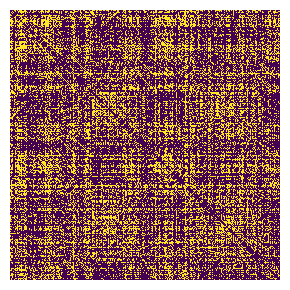

In [115]:
X_proc = se.emphasize_diagonals()
se.display_matrix(X_proc)

We can tune parameters visually using the `se.display_matrix` to view the processed plot. One of the most important parameters is the binary threshold, `bin_thresh`. Let's iterate through a sample and choose one that balances noise and segment integrity

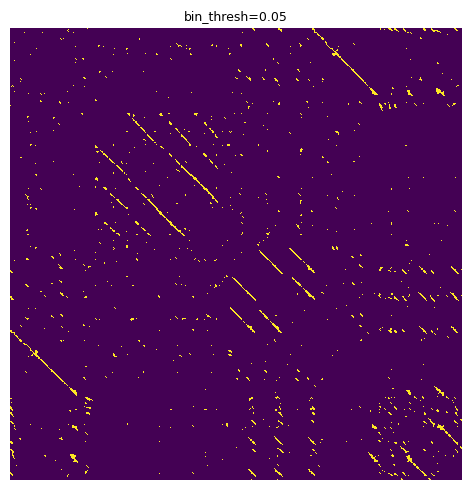

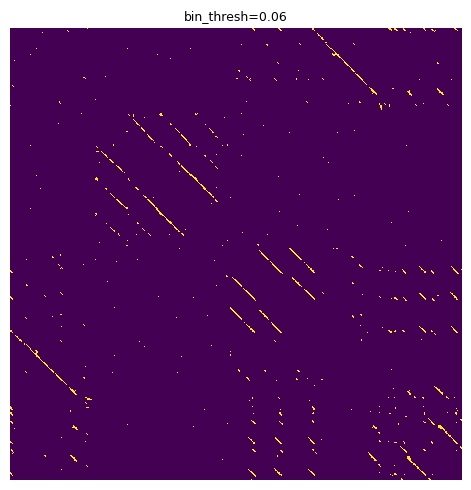

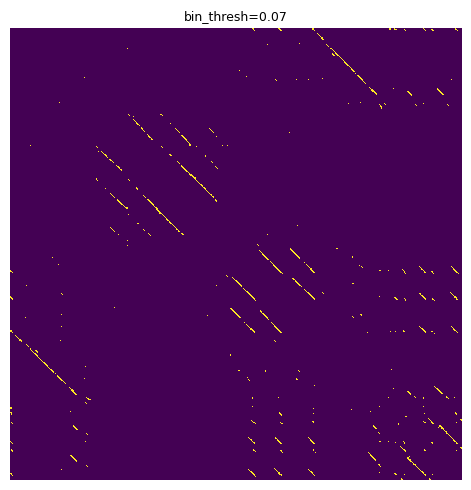

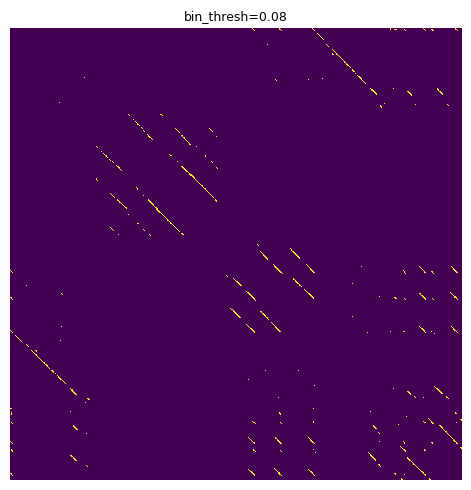

In [116]:
for i in np.arange(0.05, 0.09, 0.01):
    X_proc = se.emphasize_diagonals(bin_thresh=i)
    se.display_matrix(X_proc[2000:5000,2000:5000], title=f'bin_thresh={round(i,2)}', figsize=(5,5))

We are looking for a solution that reduces the "speccy" noise parts and leaves strong, consistent diagonal segments.
0.1 seems like an OK choice

In [117]:
X_proc = se.emphasize_diagonals(bin_thresh=0.10)

Finally we extract segments using a combination of geometric techniques:
- Identify individual regions of non 0 values using a two-pass binary connected-components labelling algorithm (CCL)
- Identify centroid of region
- Idenitfy quadrant centroids
- Define path through these centroids using least squares
- Terminate path at bounding box of segment

<div>
<figure>
<img src="../images/extracting_segments.png" width="500"/>
</figure>
</div>

In [118]:
all_segments = se.extract_segments(
    timestep=timestep, # timestep between
    boundaries=boundaries_sparse, # boundaries of sparse regions (for conversion)
    lookup=sparse_orig_lookup, # To convert between sparse and true indices
    break_mask=exclusion_mask) # mask corresponding to break points, any segment that traverse these points are broken into two

In [119]:
print("Format: [(x0, y0), (x1, y1)]...")
all_segments[:10]

Format: [(x0, y0), (x1, y1)]...


[[(276, 286), (346, 356)],
 [(284, 276), (355, 347)],
 [(477, 487), (542, 551)],
 [(485, 477), (550, 542)],
 [(597, 607), (757, 767)],
 [(605, 597), (766, 758)],
 [(813, 823), (936, 946)],
 [(821, 813), (945, 937)],
 [(1080, 1089), (1150, 1159)],
 [(1089, 1080), (1159, 1150)]]

<a id='4.4'></a>

### 4.4 Segment grouping
Each segment corresponds to two regions of the audio, one on the x axis and one on the y axis. We want to convert these segments to start and end points of individual patterns and group these patterns into groups of occurrences of the same pattern. 

`segmentExtractor` has a grouping method which achieves this using a combination of the gemoetry of X and pairwise distances between patterns. First segments are grouped based on their alignment in the x and y direction. Subsequently, groups are merged together based on the average dynamic-time-warping distance between them.

A mask corresponding to anchor points to which we might want to extent returned patterns to can be passed to `segmentExtractor.group_segments` and any patterns that end or begin close to these points will be extended to them. Since regions of silence and stability serve as plasusible segmentation points between patterns we pass a mask indicating where the centers are for these regions.

In [120]:
from compiam.utils import add_center_to_mask

In [121]:
exclusion_mask_center = add_center_to_mask(exclusion_mask)
anchor_mask = np.array([1 if i==2 else 0 for i in exclusion_mask_center])

In [122]:
# Returns patterns in units of pitch sequence elements
starts_seq, lengths_seq = se.group_segments(
    all_segments, # segments from se.extract_segments()
    anchor_mask, # Extend patterns to these points
    pitch, # pitch track
    min_pattern_length_seconds=2 # minimum pattern length
)


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 252.08it/s]


The process returns groups of patterns in terms of start point and length. The units for these patterns correspond to elements in the pitch track. We can convert to seconds as so:

In [123]:
starts_sec = [[x*timestep for x in p] for p in starts_seq]
lengths_sec = [[x*timestep for x in l] for l in lengths_seq]

In [125]:
print(f"Number of groups: {len(starts_sec)}")

Number of groups: 13


<a id='4.5'></a>

### 4.5 Exploring results
Let's take a look at some results. `compiam.visualisation.pitch.plot_subsequence` is a wrapper for`compiam.visualisation.pitch.plot_pitch` that allows us to inspect subsequences of a pitch plot with their surrounding melodic context

In [126]:
from compiam.visualisation.pitch import plot_subsequence
import IPython

In [127]:
# kwargs for plot_pitch
plot_kwargs = {
    'yticks_dict': svara_pitch,
    'cents':True,
    'tonic':tonic,
    'figsize':(15,4)
}

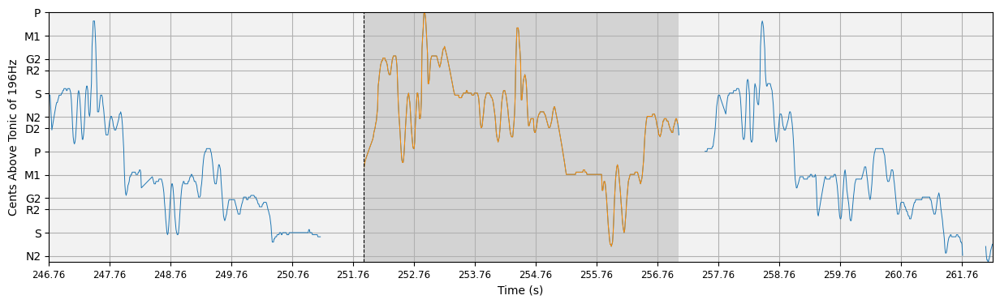

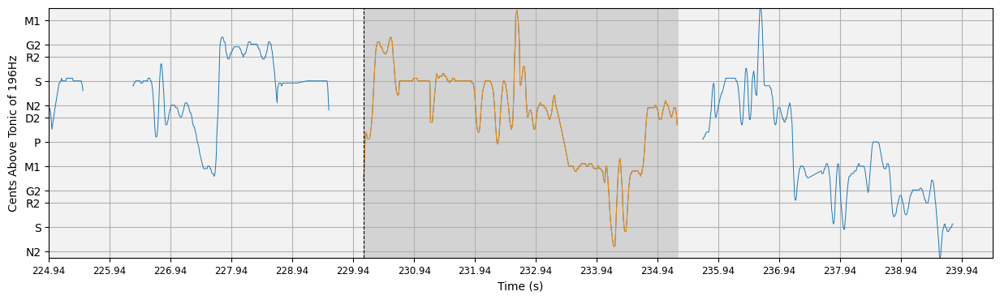

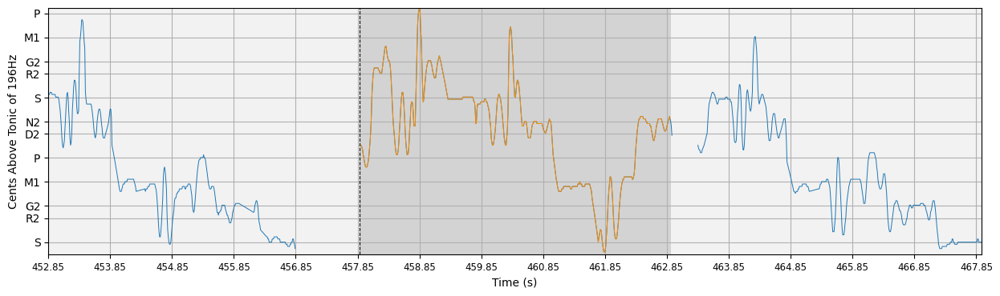

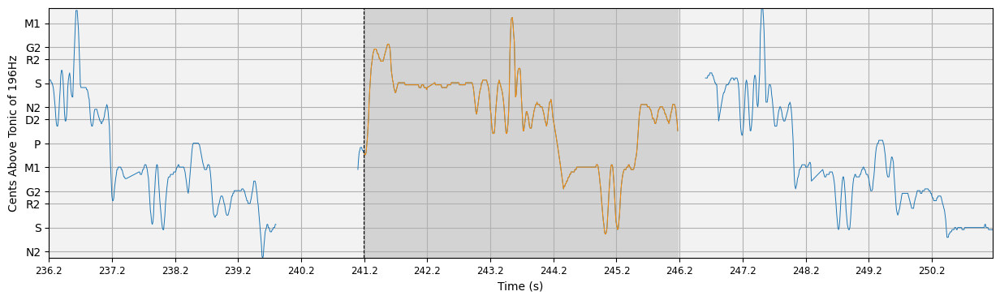

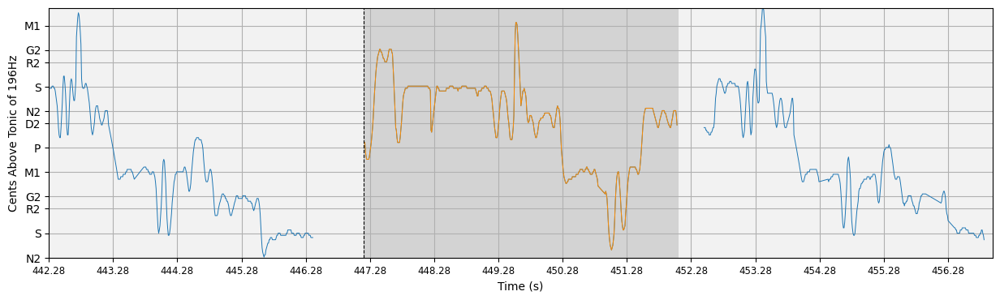

...

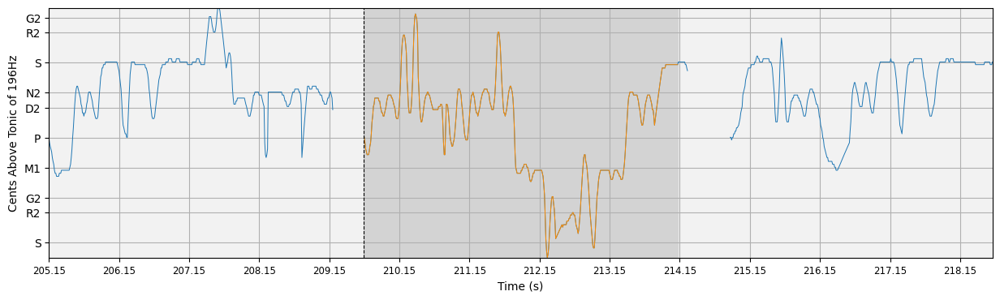

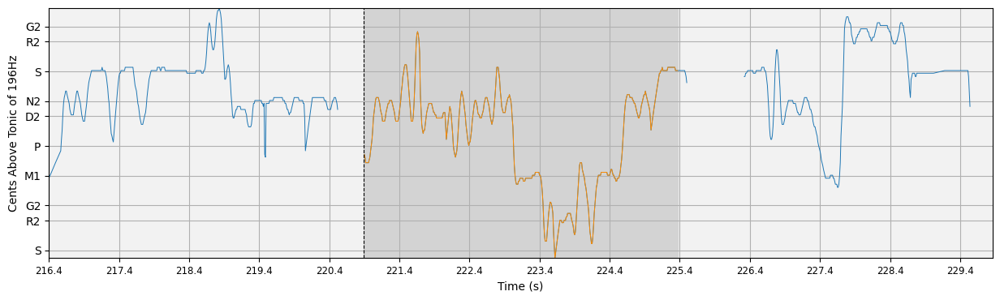

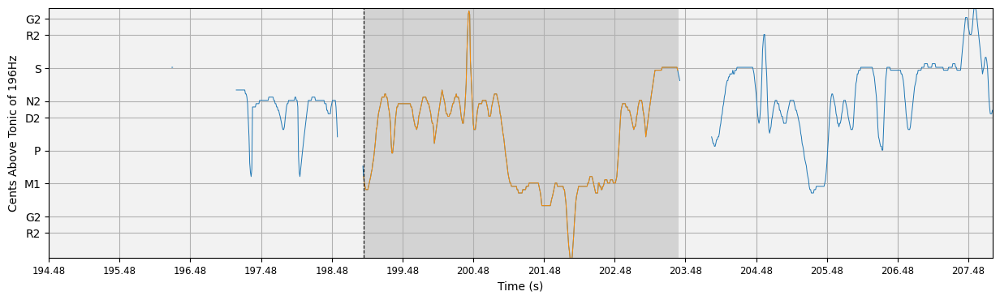

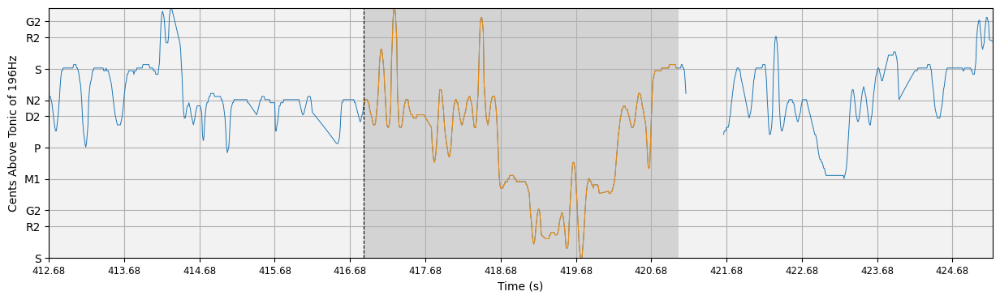

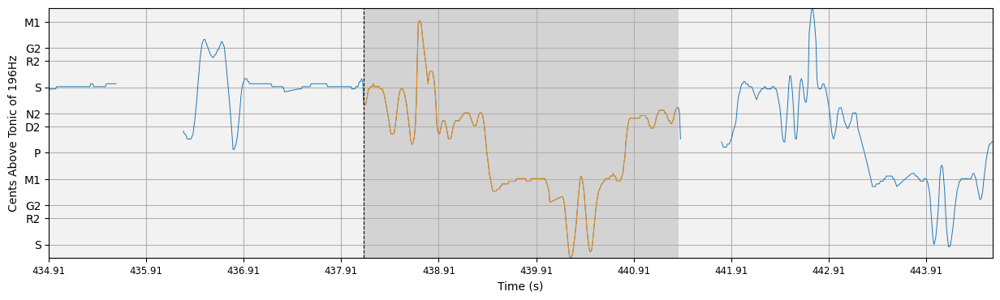

In [128]:
i = 7 # Choose pattern group

S = starts_seq[i] # get group
L = lengths_seq[i] # get lengths

for j,s in enumerate(S):
    l = L[j] # this pattern length
    ss = starts_sec[i][j] # this pattern start in seconds
    ls = lengths_sec[i][j] # this pattern length in seconds
    IPython.display.display(ipy_audio(audio, ss, ss+ls, sr=sr)) # display audio
    # display pitch plot
    plot_subsequence(s, l, pitch, time, timestep, path=None, plot_kwargs=plot_kwargs)
    plt.show()

<a id='4.6'></a>

### 4.6 Annotations
Ground-truth annotations of sañcāras in certain audio recordings were created by contributor and professional vocalist, Brindha Manickavasakan. Annotations were created in Carnatic notation, known as sargam [14]. As there is no definitive list of sañcāras in a given rāga, the segmentations are based on the annotator’s experience as a professional performer and student of a highly esteemed musical lineage. These annotations are therefore subjective to some degree, but have the benefit of being based on expert performer knowledge rather than on an externally imposed metric that may be irrelevant to musical concepts held by culture bearers [12].

The annotations can be loaded using `compiam.load_dataset`

In [129]:
from compiam.melody.pattern import load_annotations, to_aeneas

In [134]:
annotations_path = "../../annotations/47_Koti_Janmani.txt"
annotations = load_annotations(annotations_path)

In [135]:
annotations

,tier,s1,s2,text,text_full
0,underlying_sancara,5.2,8.3,mgmpmmgrg,mgmpmmgrg
1,underlying_full_phrase,67.4,72.3,ppmmgmpgpmgrs,ppmmgmpgpmgrs
2,underlying_sancara,69.1,72.3,mmgmpgpmgrs,mmgmpgpmgrs
3,underlying_sancara,72.5,75.2,sssnnpn,sssnnpn
4,underlying_sancara,75.4,78.8,smmggmggrs,smmggmggrs
...,...,...,...,...,...
131,underlying_full_phrase,473.4,479.6,nrsnsndmgmpmgrgmgmn,nrsnsndmgmpmgrgmgmn
132,underlying_sancara,476.3,478.8,gmpmgrgm,gmpmgrgm
133,underlying_sancara,481.3,484.1,mmgmpgpmgrs,mmgmpgpmgrs
134,underlying_sancara,484.1,487.0,sssnnpn,snsmgrsnnpn


The waveform player presented in Section 1 accepts annotations in [aeneas format](https://www.readbeyond.it/aeneas/docs/)

In [136]:
aeneas_annotations = to_aeneas(annotations, label_row='text_full')

In [137]:
Player(title, audio_path, aeneas_annotations)

/Volumes/Shruti/asplab2/compIAM/compiam/visualisation/waveform_player/waveform-playlist/
annotations.html


Player(value='<iframe srcdoc="&lt;!DOCTYPE html&gt;\n&lt;html lang=&quot;en&quot;&gt;\n  &lt;head&gt;\n  &lt;m…

<a id='4.7'></a>

### 4.7 Evaluation
We can evaluate our returned results using the ground truth annotations and traditional IR metrics. Recall, precision and f1. A true positive is considered when overlap between a returned pattern and an annotated pattern as a proportion of their length is equal to or exceeds a certain threshold, `partial_perc`

In [138]:
from compiam.melody.pattern import evaluate

In [139]:
partial_perc = 0.66

In [140]:
recall, precision, f1, annotations_ev = evaluate(annotations, starts_sec, lengths_sec, partial_perc)
print(f"recall: {recall}")
print(f"precision: {precision}")
print(f"f1: {f1}")

recall: 0.5514705882352942
precision: 0.7168141592920354
f1: 0.623364629829152


We can take an example patttern and see the extent to which the process has identified it. For example, nnnsndmgm. Corresponding to group 9:

In [141]:
annotations_ev[annotations_ev['text']=="nnnsndmgm"]

,tier,s1,s2,text,text_full,match,group_num,occ_num
38,underlying_sancara,180.0,183.5,nnnsndmgm,nnnsndmgm,no match,NaN,NaN
42,underlying_sancara,198.7,202.3,nnnsndmgm,nnnsndmgm,match,7.0,8.0
46,underlying_sancara,209.4,213.2,nnnsndmgm,nnssndpdnndmmgrgm,match,7.0,6.0
50,underlying_sancara,220.7,224.4,nnnsndmgm,nnssndpdnndmmgrgm,match,7.0,7.0
106,underlying_sancara,376.5,379.8,nnnsndmgm,nnnsndmgm,match,8.0,0.0
111,underlying_sancara,405.9,409.2,nnnsndmgm,nnnsndmgm,match,8.0,1.0
114,underlying_sancara,416.3,420.0,nnnsndmgm,nnssndpdnndmmgrgm,match,7.0,9.0
118,underlying_sancara,427.4,430.7,nnnsndmgm,nnssndpdnndmmgrgm,match,7.0,5.0


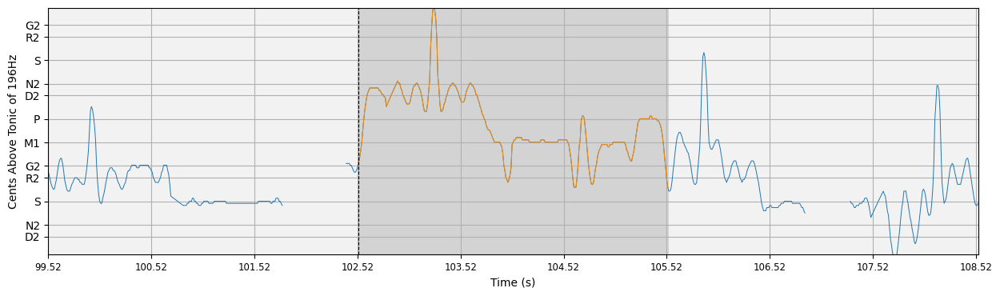

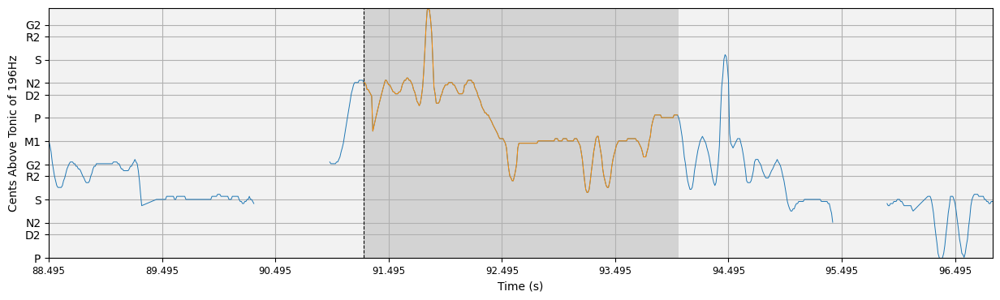

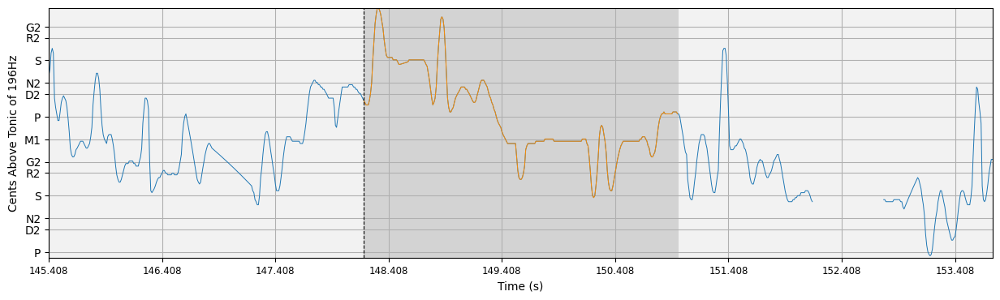

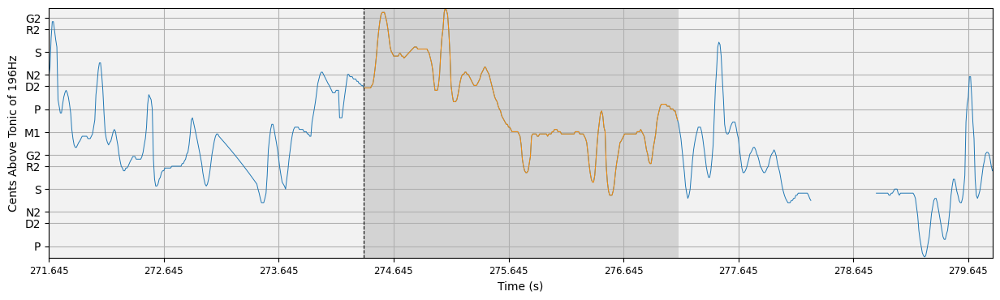

In [144]:
i = 9 # Choose pattern group

S = starts_seq[i] # get group
L = lengths_seq[i] # get lengths

for j,s in enumerate(S):
    l = L[j] # this pattern length
    ss = starts_sec[i][j] # this pattern start in seconds
    ls = lengths_sec[i][j] # this pattern length in seconds
    IPython.display.display(ipy_audio(audio, ss, ss+ls, sr=sr)) # display audio
    # display pitch plot
    plot_subsequence(s, l, pitch, time, timestep, path=None, plot_kwargs=plot_kwargs)
    plt.show()

These results differ in their annotations, but were given the same “underlying sañcāra” annotation, indicating they are elaborations on an earlier phrase. The pattern finding process picked up the underlying similarity, even though the actual notation that would be, and indeed was, given for these differs.


<a id='4.8'></a>

### 4.8 Discussion
Obtaining a decent evaluation for a high `partial_perc` is very difficult. This is due to many factors, the many faceted process often trades off one desirable feature for another: leniancy in the threshold for significance leads to mistakes filtering through; a more relaxed grouping to capture instances of the same sancara lead to regions of what is clearly not the same pattern to be grouped; a more flexible DTW threshold for grouping causes greater length variation within groups.

On top of this, the ideal boundary between shorter segments within a longer phrase is not always clear-cut, it is clear that often a longer phrase may be plausibly segmented in two or three different ways. However, there are rules of raga grammar, and understandings of typical sañca¯ras that restrict the number of plausible segmentation points. (This is similar to the segmentation of Western Art Music, where in any given section, several plausible segmentations may be made, but where the options are not unlimited).

The potential for this process at the moment is the ability to reliably shine a light on regions of the audio that may correspond to or overlap with what are considered relevant motifs and phrases.

<a id='5'></a>

## 5. Conclusion
We have explored three core aspects of raga in Carnatic music using the compIAM tools repository - svaras (pitch), gamakas (ornamentation), and sancaras (melody). Touching on topics such as melodic feature extraction, tonic/svara identification, raga classification, repeated melodic pattern recognition, pitch visualisation.

All tools and proccesses presented here are openly available and accessible at the [online repository](https://github.com/MTG/compIAM/tree/master/compiam), technical documentation is available at our [sphinx page](https://mtg.github.io/compIAM/) and an online web book with code walkthroughs and musicological background available in our [webbook](https://mtg.github.io/IAM-tutorial-ismir22/landing.html).

compIAM is in it's infancy and growing in size and number of contributors. If you would like to get involved and contribute to this repository of tools for the computational analysis of Indian Art Music, or want to get in touch for any other related question or feedback you can do so by contacting [Thomas Nuttall](mailto:thomas.nuttall@upf.edu) or [Genís Plaja-Roglans](mailto:genis.plaja@upf.edu).
<a id='6'></a>

## 6. References
[1] Lara Pearson, Brindha Manickavasakan (2022). Computational Methods for Supporting Corpus-Based Research on Indian Art Music, What is Indian Art Music?. https://mtg.github.io/IAM-tutorial-ismir22.

[2] N. Ramanathan. Sargam and musical conception in Karnataka system. In Sargam as a musical material. Mumbai, 2004. Dr. Prabha Atrre Foundation, Pu. La. Deshpande Maharashtra Kala Academy.

[3] Tanjore Viswanathan. The Analysis of Rāga ālāpana in South Indian Music. Asian Music, 9(1):13–71, 1977.

[4] Ludwig Pesch. The Oxford illustrated companion to South Indian classical music. Oxford University Press, New Delhi, 2009. ISBN 0-19-564382-8

[5] Vignesh Ishwar, Shrey Dutta, Ashwin Bellur, and Hema A Murthy. Motif Spotting in an Alapana in Carnatic Music. In Proc. of the 14th International Society for Music Information Retrieval Conference (ISMIR), Curitiba, Brazil, 499–504. 2013.

[6] Nuttall, Thomas, Genís Plaja, Lara Pearson, and Xavier Serra. "The Matrix profile for motif discovery in audio-an example application in Carnatic music." In Proc. of the 15th International Symposium on Computer Music Multidisciplinary Research; 2021.

[7] Pearson, L.: Coarticulation and gesture: an analysis of melodic movement in South Indian rāga performance. In: Music Analysis, 35(3), pp. 280-313 (2016)

[8]  G. Plaja-Roglans, T. Nuttall, L. Pearson, and X. Serra, “Repertoire specific vocal pitch data generation for improved melodic analysis of carnatic music,” 2022. [Online]. Available: 10.5281/zenodo.7036117 

[9] S. Yu, X. Sun, Y. Yu, and W. Li, “Frequency-Temporal Attention Network for Singing Melody Extraction,” In Proc. of the IEEE Int. Conf. on Acoustics, Speech and Signal Processing (ICASSP), Toronto, Canada, pp.
251–255, 2021. 

[10] TBA. (2021). Saraga-Carnatic-Melody-Synth (1.0) [Data set]. Zenodo. https://doi.org/10.5281/zenodo.5553925

[11] T. Viswanathan, “The analysis of raga alapana in South Indian music,” Asian Music, vol. 9, no. 1, pp. 13–71, 1977.

[12] Nuttall, Thomas, Genís Plaja-Roglans, Lara Pearson, and Xavier Sierra. "In search of Sañcāras: tradition-informed repeated melodic pattern recognition in carnatic music." (2022).

[13] S. Lattner, A. Arzt, and M. Dörfler, “Learning complex basis functions for invariant representations of audio,” In Proc. of the 20th Int. Society for Music Information Retrieval Conf. (ISMIR), Delft, The Netherlands, 2019.

[14] N. Ramanathan, “Sargam and musical conception in karnataka system’,” Sargam as a musical material, 2004.